In [79]:
import torch
from torch.utils.data import DataLoader

from src.utils_data import load_PeMS04_flow_data, preprocess_PeMS_data, createLoaders, TimeSeriesDataset
from src.utils_graph import compute_laplacian_with_self_loop
from src.models import TGCN, GRUModel, LSTMModel, train_model

import pandas as pd

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Preprocessing data

In [80]:
df_PeMS, df_distance  = load_PeMS04_flow_data()
n_neighbors = 15
normalization = "divide_by_max"
df_PeMS, adjacency_matrix_PeMS, maximum = preprocess_PeMS_data(df_PeMS, df_distance, init_node=0, n_neighbors=n_neighbors, normalize=True)

c:\Users\gcogoni\Documents\Stage\Federated-Traffic-Flow-Forecasting\src\utils_graph.py:98: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  return nx.adjacency_matrix(graph, nodelist=nodes_order, weight=None).toarray()


In [81]:
# Define the sliding window size and stride
_window_size = 7
_stride = 1

## TGCN

In [82]:
train_loader_TGCN, val_loader_TGCN, test_loader_TGCN = createLoaders(df_PeMS, window_size=_window_size, stride=_stride)
model_TGCN = TGCN(adjacency_matrix_PeMS, hidden_dim=32, output_size=len(df_PeMS.columns))

In [83]:
# import matplotlib.pyplot as plt

# num_epochs_TGCN = 150
# model_path = f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_TGCN}/TGCN_model.pkl"
# _ , valid_losses, train_losses = train_model(model_TGCN, train_loader_TGCN, val_loader_TGCN, model_path=model_path, num_epochs=num_epochs_TGCN, remove=False)
# plt.figure(figsize=(25, 9))
# plt.title("TCGN")
# plt.plot(train_losses, label="train_losses")
# plt.legend(fontsize=12)
# plt.show()
# plt.figure(figsize=(25, 9))
# plt.title("TCGN")
# plt.plot(valid_losses, label="valid_losses")
# plt.legend(fontsize=12)
# plt.show()

## Univariate 

### LSTM

In [84]:
models_univaritate_LSTM = {}

for i in range(n_neighbors+1):
    #print(f"LSTMModel {i}")
    train_loader, val_loader, test_loader = createLoaders(pd.DataFrame(df_PeMS.iloc[:, i]), window_size=_window_size, stride=_stride)
    models_univaritate_LSTM[f"LSTMModel {i}"] = {
                                                "model": LSTMModel(1, 32, 1),
                                                "train_loader": train_loader,
                                                "val_loader": val_loader,
                                                "test_loader": test_loader
    }

In [85]:
num_epochs_LSTM_univariate = 200

# for i in range(n_neighbors+1):
#     _, valid_losses, train_losses = train_model(models_univaritate_LSTM[f"LSTMModel {i}"]["model"], 
#                 models_univaritate_LSTM[f"LSTMModel {i}"]["train_loader"], 
#                 models_univaritate_LSTM[f"LSTMModel {i}"]["val_loader"], 
#                 f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_LSTM_univariate}/univariate_LSTM_model_{i}.pkl", num_epochs=num_epochs_LSTM_univariate, remove=False)
#     plt.figure(figsize=(25, 9))
#     plt.title(f"LSTM captor {i} TRAIN LOSSES")
#     plt.plot(train_losses, label="train_losses")
#     plt.legend(fontsize=12)
#     plt.show()
#     plt.figure(figsize=(25, 9))
#     plt.title(f"LSTM captor{i} VALID LOSSES")
#     plt.plot(valid_losses, label="valid_losses")
#     plt.legend(fontsize=12)
#     plt.show()

### GRU

In [86]:
models_univaritate_GRU = {}

for i in range(n_neighbors+1):
    #print(f"GRUModel {i}")
    train_loader, val_loader, test_loader = createLoaders(pd.DataFrame(df_PeMS.iloc[:, i]), window_size=_window_size, stride=_stride)
    models_univaritate_GRU[f"GRUModel {i}"] = { 
                                                "model": GRUModel(1, 32, 1),
                                                "train_loader": train_loader,
                                                "val_loader": val_loader,
                                                "test_loader": test_loader
    }

In [87]:
num_epochs_univaritate_GRU = 200

# for i in range(n_neighbors+1):
#     _, valid_losses, train_losses = train_model(models_univaritate_GRU[f"GRUModel {i}"]["model"], 
#                 models_univaritate_GRU[f"GRUModel {i}"]["train_loader"], 
#                 models_univaritate_GRU[f"GRUModel {i}"]["val_loader"], 
#                 f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_univaritate_GRU}/univariate_GRU_model_{i}.pkl", num_epochs=num_epochs_univaritate_GRU, remove=False)
#     plt.figure(figsize=(25, 9))
#     plt.title(f"GRU captor {i} TRAIN LOSSES")
#     plt.plot(train_losses, label="train_losses")
#     plt.legend(fontsize=12)
#     plt.show()
#     plt.figure(figsize=(25, 9))
#     plt.title(f"GRU captor{i} VALID LOSSES")
#     plt.plot(valid_losses, label="valid_losses")
#     plt.legend(fontsize=12)
#     plt.show()

## Results Multivariate vs Univariate (TGCN VS LSTM - GRU)

In [88]:
def result_prediction(predictions, actuals):
    from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
    import numpy as np
    
    indices_by_month = []
    EPSILON = 1e-5
    # Créer une liste vide pour stocker les données du tableau
    data = []
    y_pred = predictions[:]
    y_true = actuals[:]

    signe = "-" if np.mean(y_pred - y_true) < 0 else "+"
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mape = mean_absolute_percentage_error(y_true, y_pred)*100
    if (mape > 1 or mape < 0):
        mape = "ERROR"
    smape = np.mean(2 * np.abs(y_pred - y_true) / (np.abs(y_true) + np.abs(y_pred)))*100
    maape =  np.mean(np.arctan(np.abs((y_true - y_pred) / (y_true + EPSILON))))*100
    
    return [signe, mae, rmse, mape, smape, maape]

In [89]:
def highlight_col(col, min_val):
    if col.name == "MAAPE":
        color = ['green' if val <= min_val else 'red' for val in col]
        return [f'background-color: {c}' for c in color]
    else :
        return ['' for _ in range(len(col))]


In [90]:
def highlight_rows(row, min_val, max_val):
    if row["MAAPE"] == min_val:
        color = "green"
    elif row["MAAPE"] == max_val:
        color = "red"
    else:
        color = ""
    
    return [f'background-color: {color}'] * len(row)

In [91]:
######################################################################
# Divide by max
######################################################################
def test_model_divide_by_max(best_model, test_loader, maximum):
    import numpy as np
    
    # Load the best model and evaluate on the test set
    best_model.double()
    best_model.eval()
    criterion = torch.nn.MSELoss()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    best_model.to(device)

    # Evaluate the model on the test set
    test_loss = 0.0
    predictions = []
    actuals = []
    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs = (inputs).to(device)
            targets = (targets).squeeze().to(device)
            outputs = best_model(inputs).squeeze()
            loss = criterion(outputs, targets)
            test_loss += loss.item()
            # Save the predictions and actual values for plotting later
            predictions.append(outputs.cpu().numpy())
            actuals.append(targets.cpu().numpy())
    test_loss /= len(test_loader)
    # print(f"Test Loss: {test_loss:.4f}")
    
    # Concatenate the predictions and actuals
    predictions = np.concatenate(predictions, axis=0)
    actuals = np.concatenate(actuals, axis=0)

    return (predictions*maximum, actuals*maximum)

In [92]:
######################################################################
# Center_reduce
######################################################################
def test_model_center_reduce(best_model, test_loader, meanstd_dict):
    import numpy as np
    
    # Load the best model and evaluate on the test set
    best_model.double()
    best_model.eval()
    criterion = torch.nn.MSELoss()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    best_model.to(device)

    # Evaluate the model on the test set
    test_loss = 0.0
    predictions = []
    actuals = []
    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs = inputs.to(device)
            targets = targets.squeeze().to(device)
            outputs = best_model(inputs).squeeze()
            loss = criterion(outputs, targets)
            test_loss += loss.item()
            # Save the predictions and actual values for plotting later
            predictions.append(outputs.cpu().numpy())
            actuals.append(targets.cpu().numpy())
    test_loss /= len(test_loader)
    print(f"Test Loss: {test_loss:.4f}")
    # Concatenate the predictions and actuals
    predictions = np.concatenate((predictions*meanstd_dict["std"]) + meanstd_dict["mean"], axis=0)
    actuals = np.concatenate((actuals*meanstd_dict["std"]) + meanstd_dict["mean"], axis=0)

    return (predictions, actuals)

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 68,-,15.230737,20.994156,ERROR,17.004402,15.961273
LSTM Model captor 68,+,4.460950,5.440597,ERROR,5.344431,5.507708
GRU Model captor 68,-,3.695895,4.731620,ERROR,4.378005,4.432885


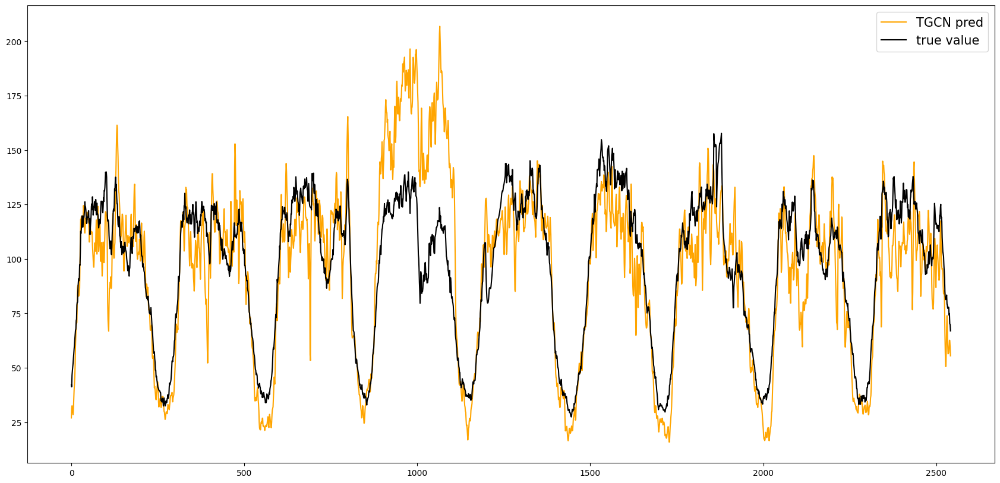

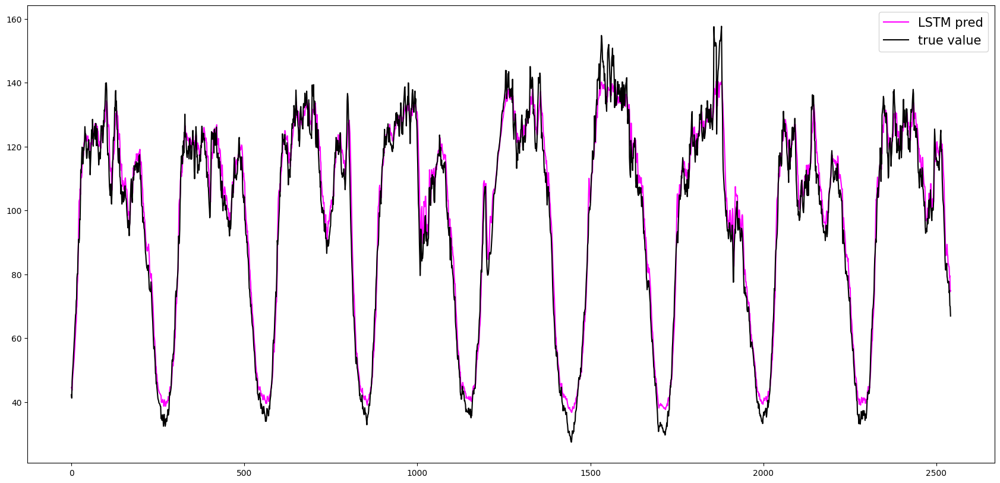

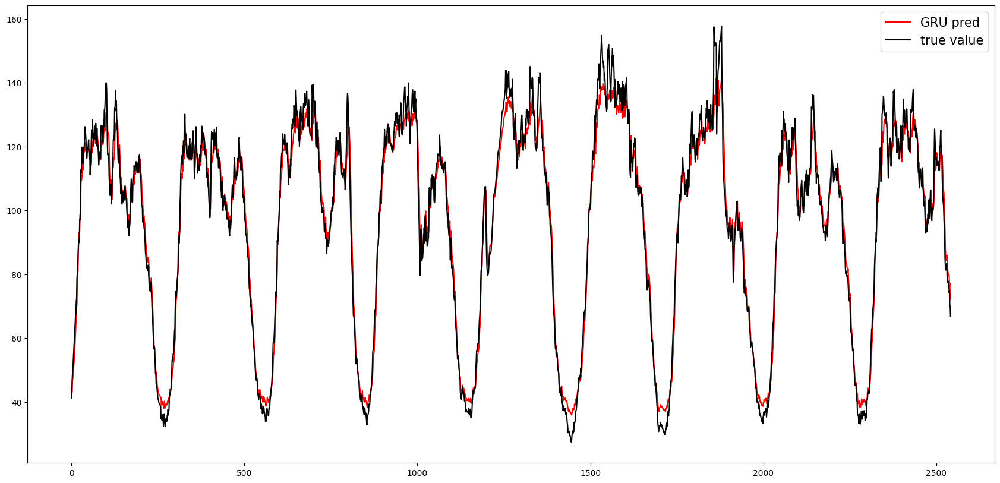

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 62,-,7.573504,9.879065,ERROR,8.347157,8.189107
LSTM Model captor 62,+,8.268874,11.225665,ERROR,10.648253,11.017748
GRU Model captor 62,+,8.105658,11.534124,ERROR,11.405366,12.169371


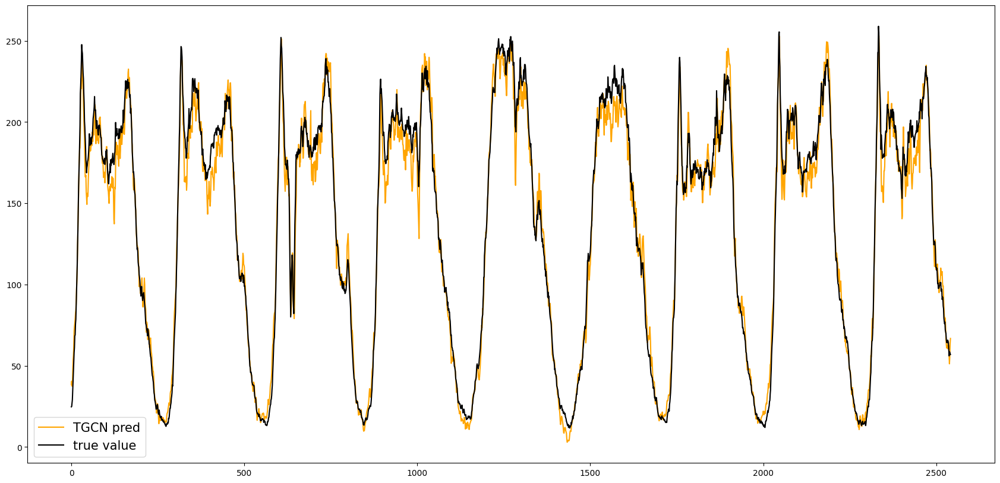

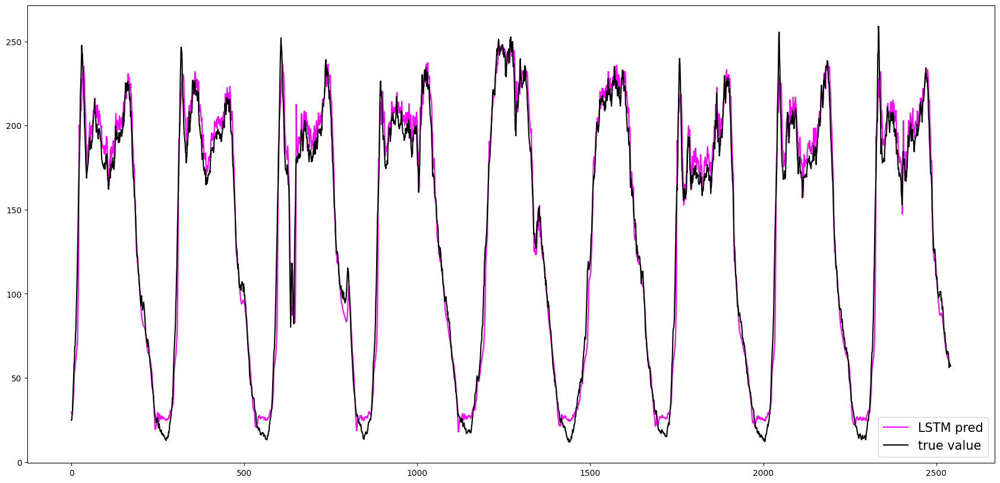

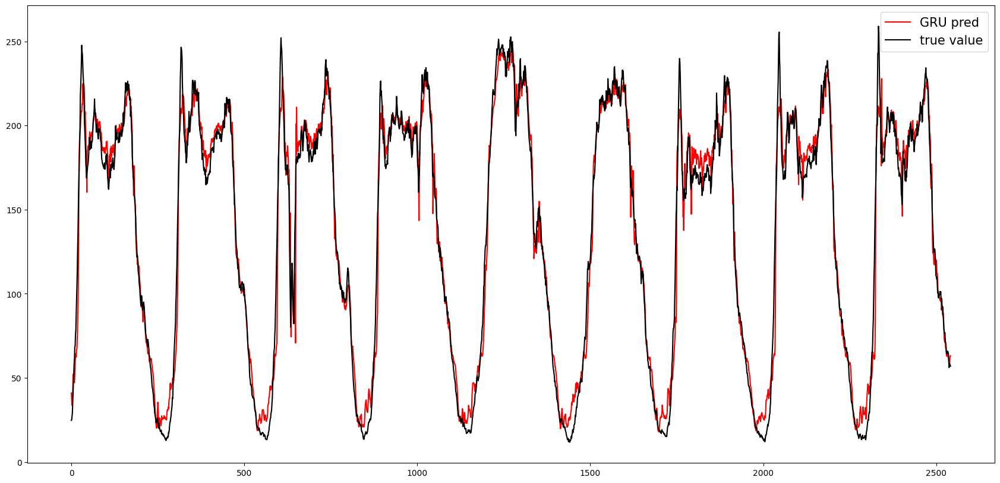

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 104,-,10.864675,14.363090,ERROR,22.341611,15.617680
LSTM Model captor 104,-,12.181245,16.365045,ERROR,13.305654,12.603345
GRU Model captor 104,-,5.629638,7.882338,ERROR,5.139095,5.004337


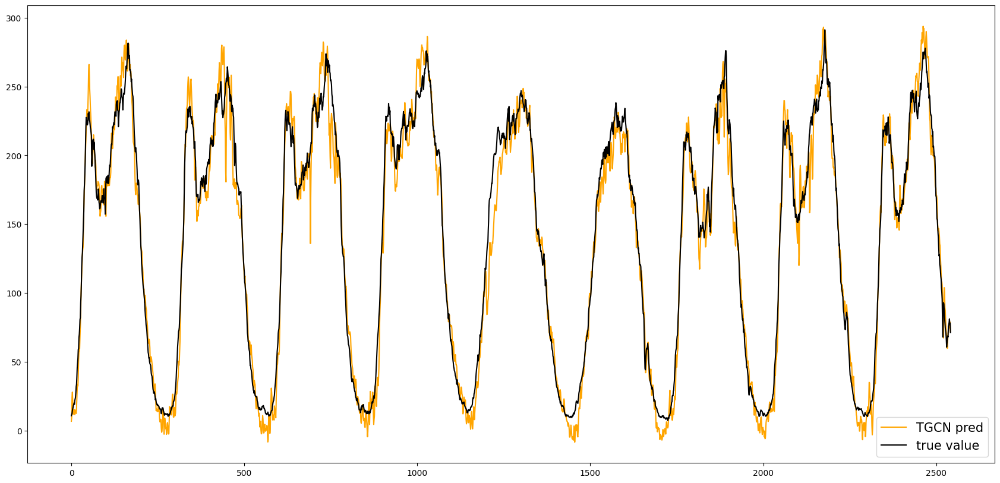

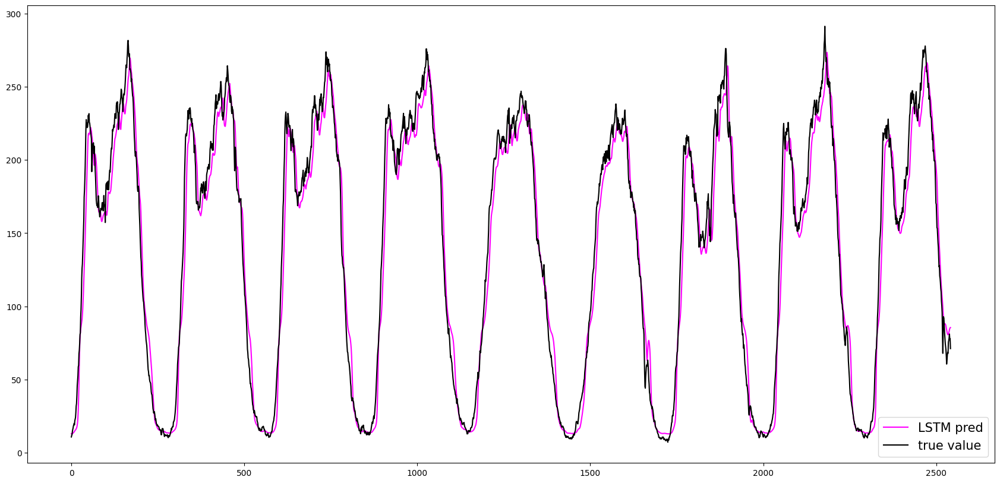

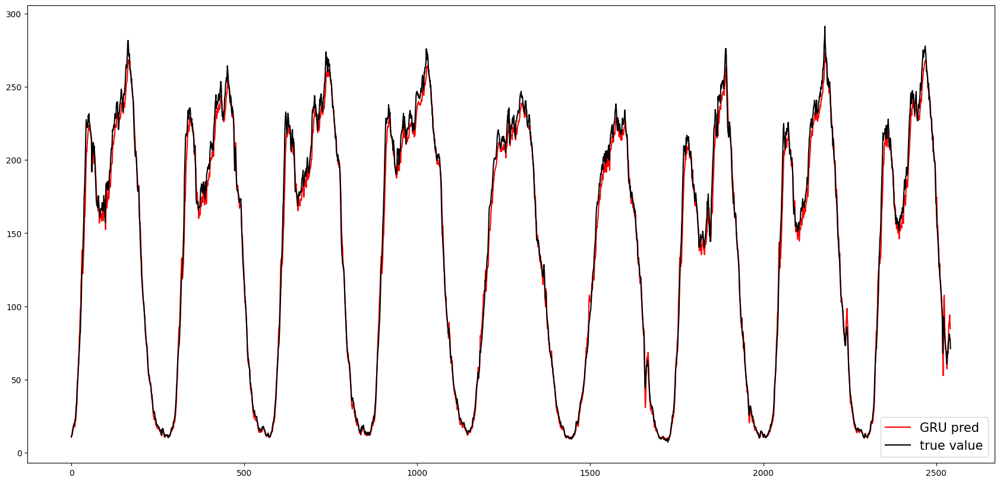

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 242,+,12.153047,15.516903,ERROR,35.026877,31.015119
LSTM Model captor 242,-,11.315111,14.700444,ERROR,36.997929,33.496648
GRU Model captor 242,+,10.648759,13.548026,ERROR,37.178321,33.429776


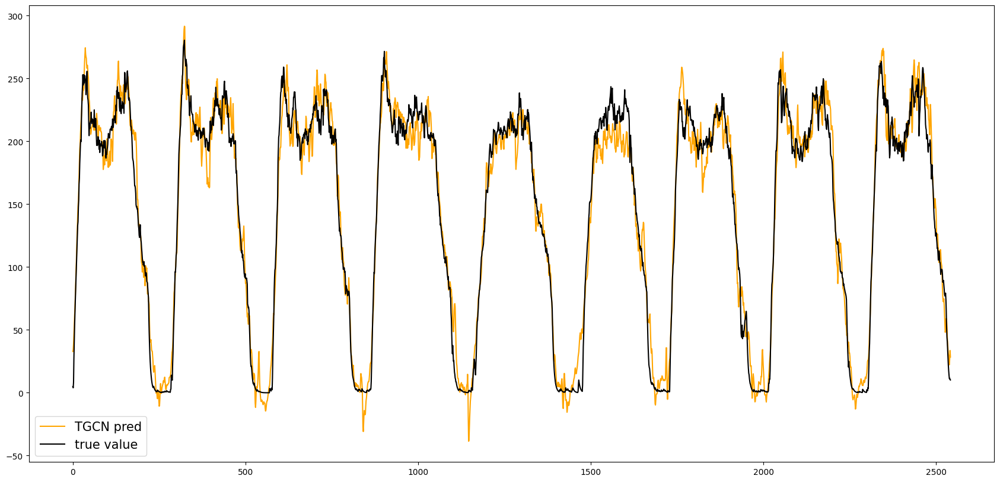

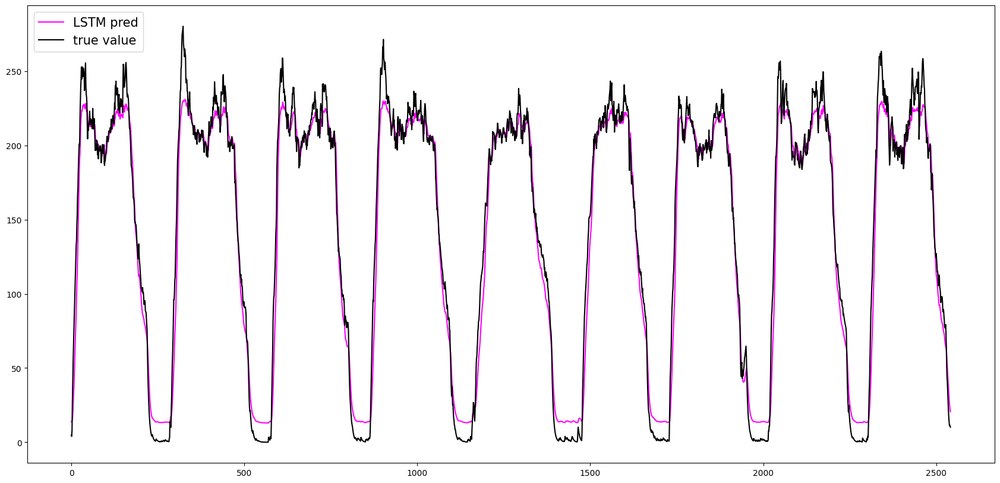

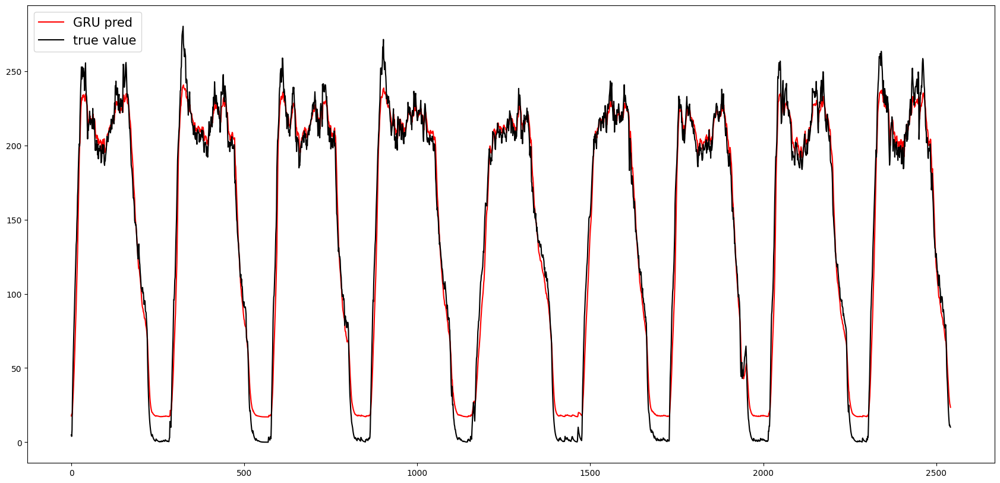

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 243,-,11.675503,14.972247,ERROR,10.854630,9.699721
LSTM Model captor 243,-,7.885825,10.865534,ERROR,8.354084,8.643281
GRU Model captor 243,-,6.385716,8.323793,ERROR,6.683646,6.838652


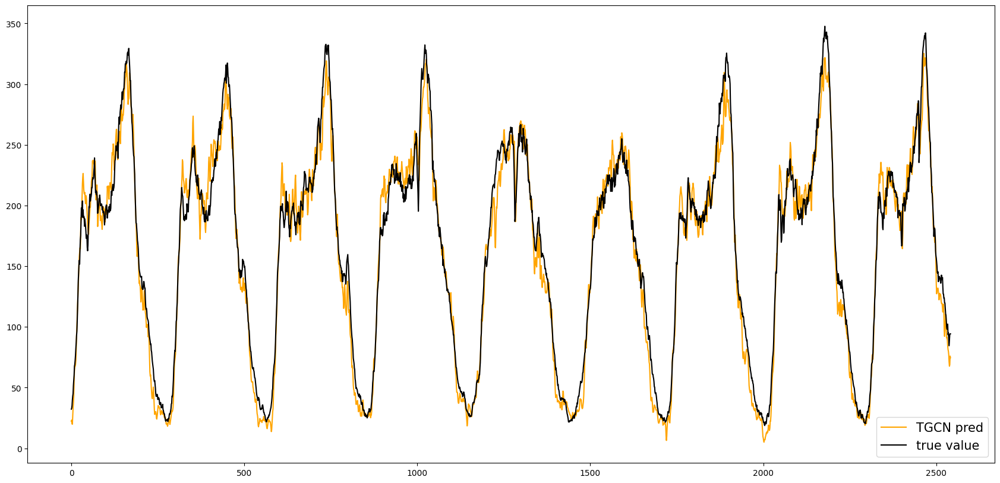

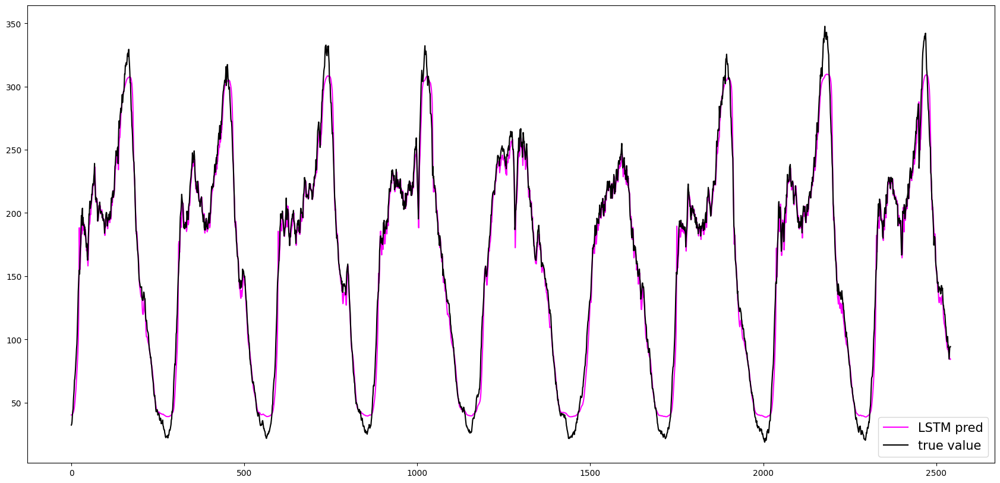

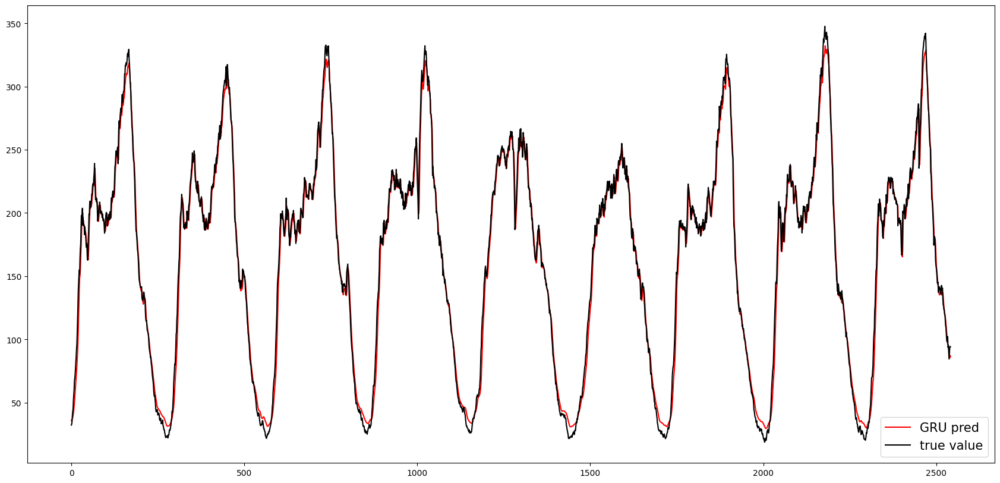

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 117,-,13.562869,17.753652,ERROR,7.855581,8.119953
LSTM Model captor 117,-,19.697433,26.560238,ERROR,10.158397,10.022032
GRU Model captor 117,-,19.331597,26.025650,ERROR,11.476002,11.956097


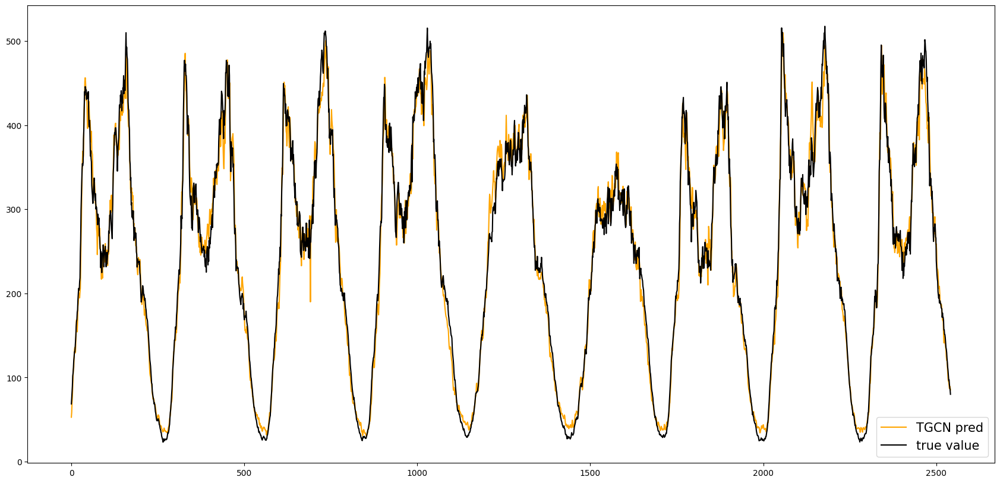

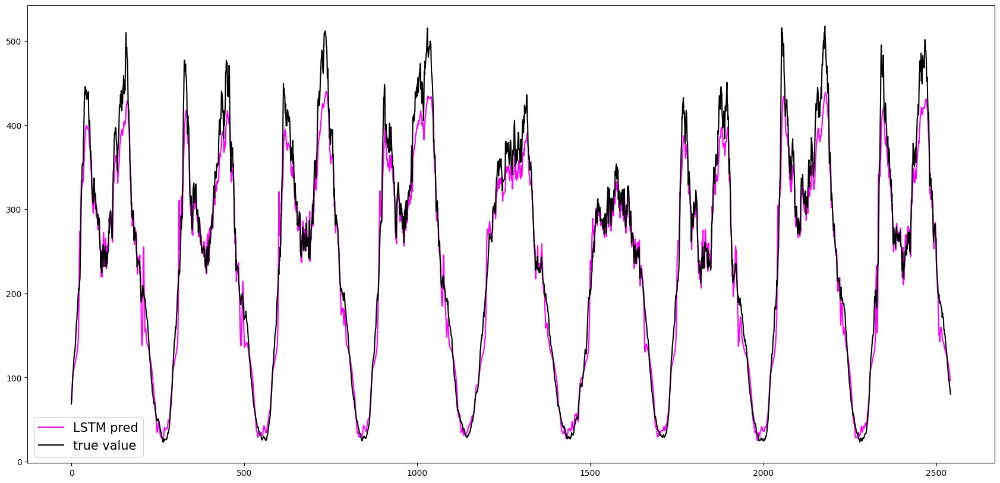

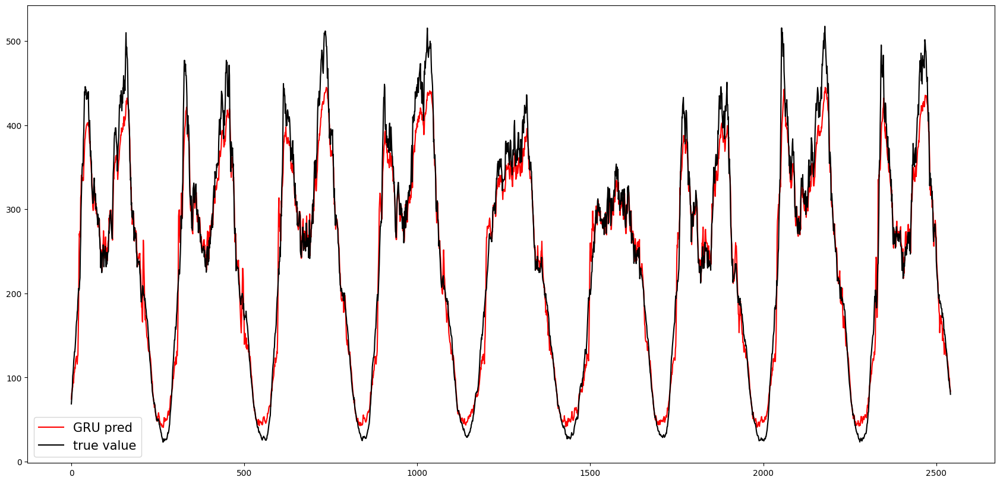

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 28,-,18.941297,30.177707,ERROR,8.279173,7.777560
LSTM Model captor 28,-,13.505451,17.993528,ERROR,6.373599,6.436044
GRU Model captor 28,-,12.699257,16.554193,ERROR,6.441419,6.564352


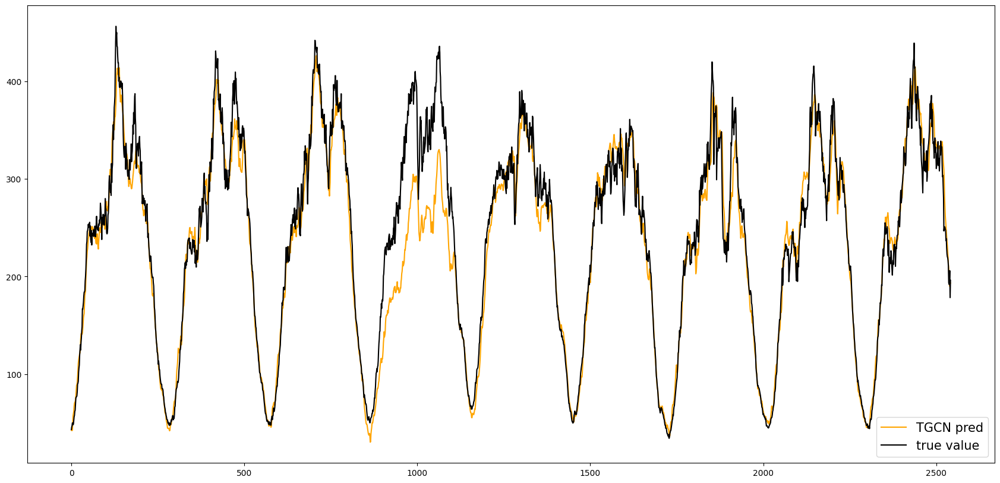

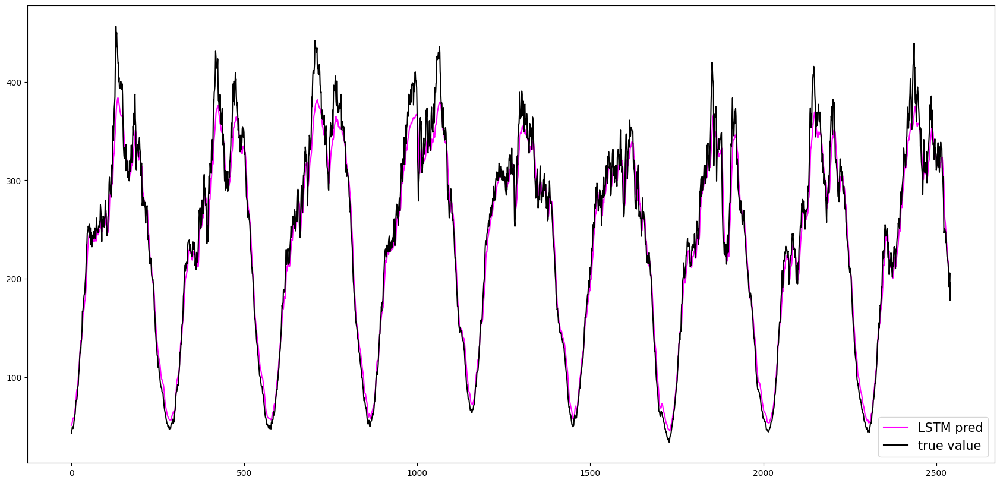

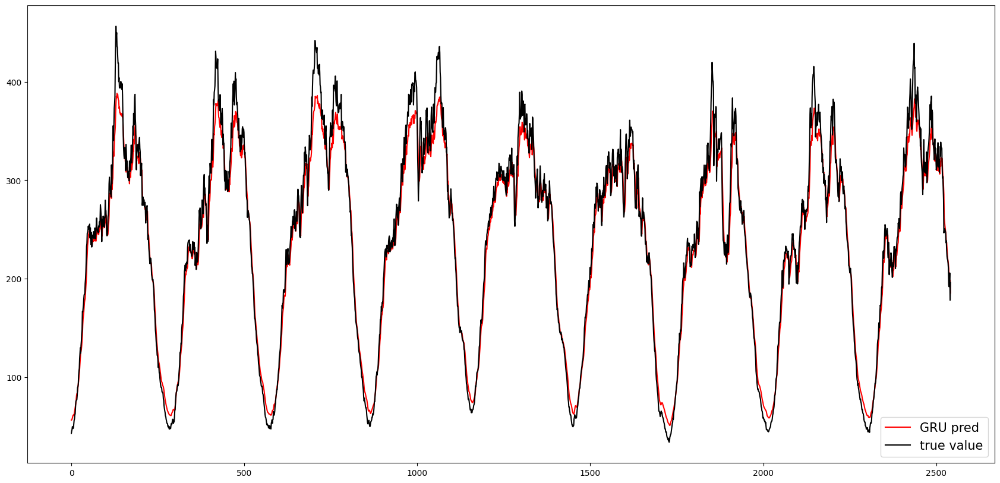

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 170,-,14.378911,19.978670,ERROR,8.416238,8.241223
LSTM Model captor 170,-,15.382096,19.916525,ERROR,7.593370,7.479212
GRU Model captor 170,-,11.600781,15.593521,ERROR,6.040736,6.199605


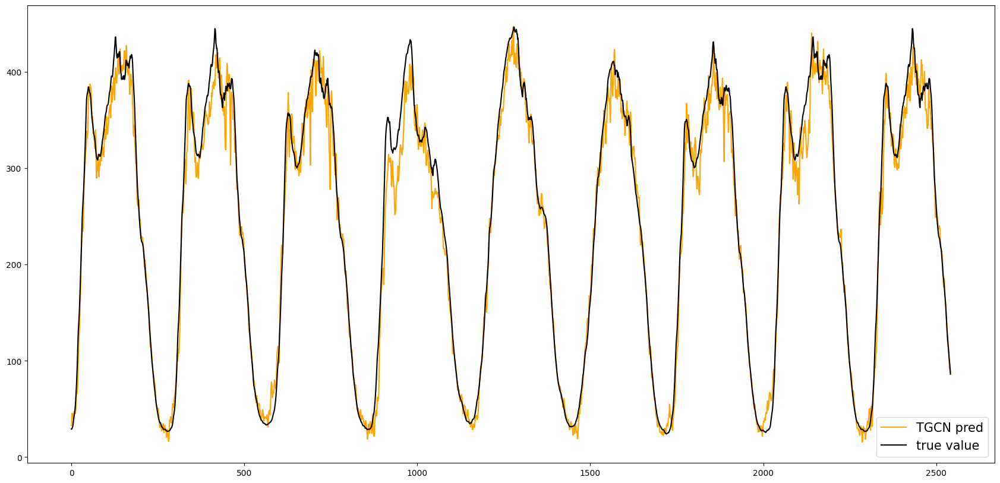

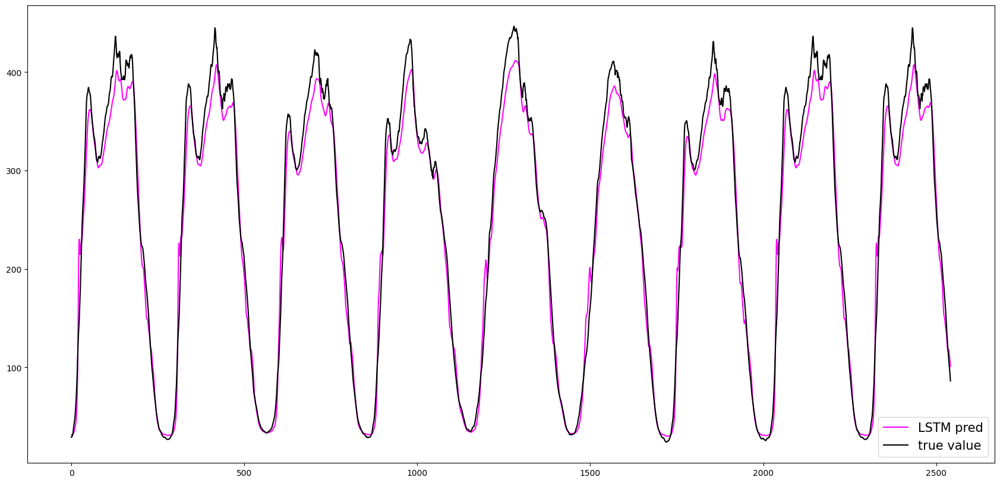

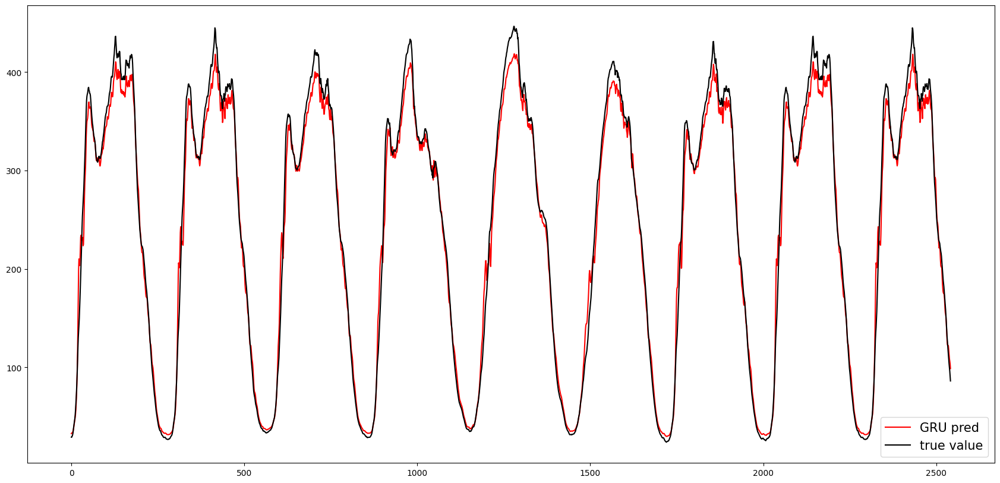

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 0,-,12.987837,16.944540,ERROR,6.949282,6.641163
LSTM Model captor 0,-,17.794772,23.489659,ERROR,12.324016,13.152143
GRU Model captor 0,+,18.169485,22.885901,ERROR,11.880492,12.612733


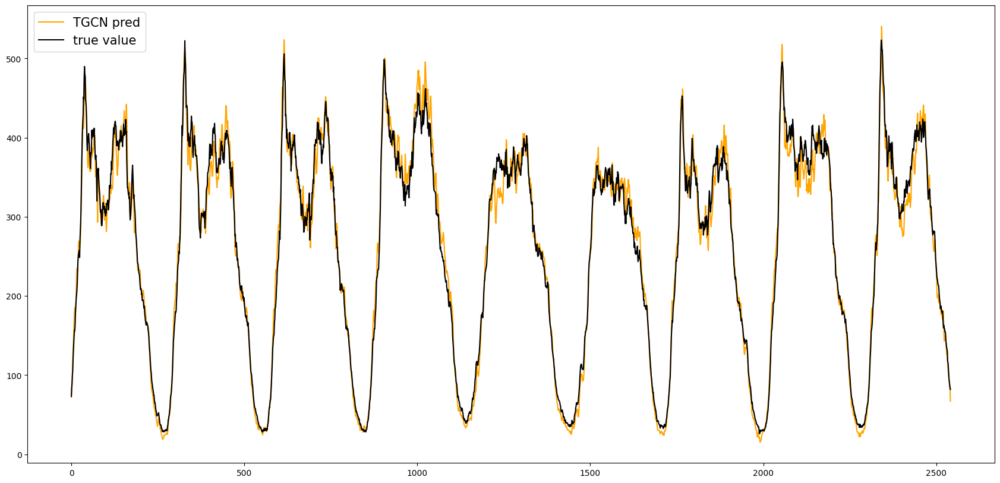

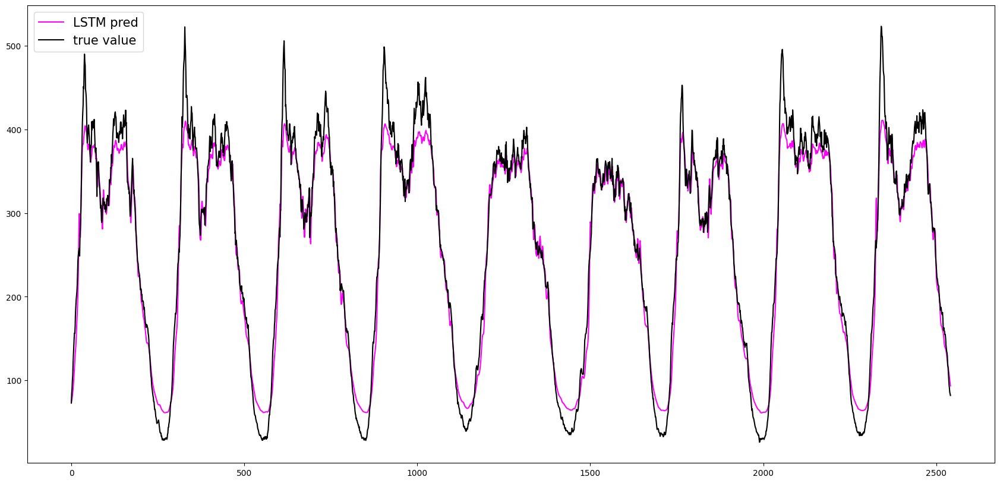

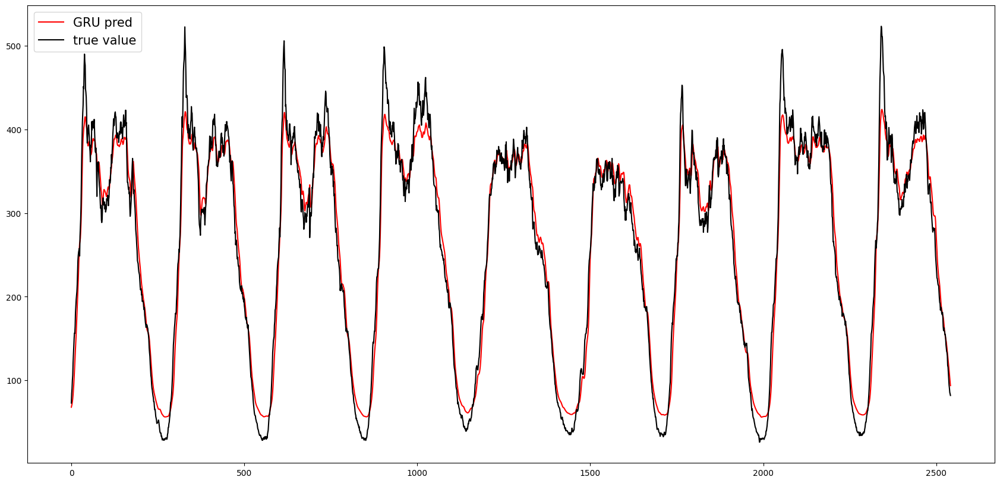

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 18,-,10.413811,13.539720,ERROR,13.902083,11.575239
LSTM Model captor 18,+,15.325087,19.800797,ERROR,16.508974,16.012024
GRU Model captor 18,-,11.114795,14.411951,ERROR,13.861655,13.498617


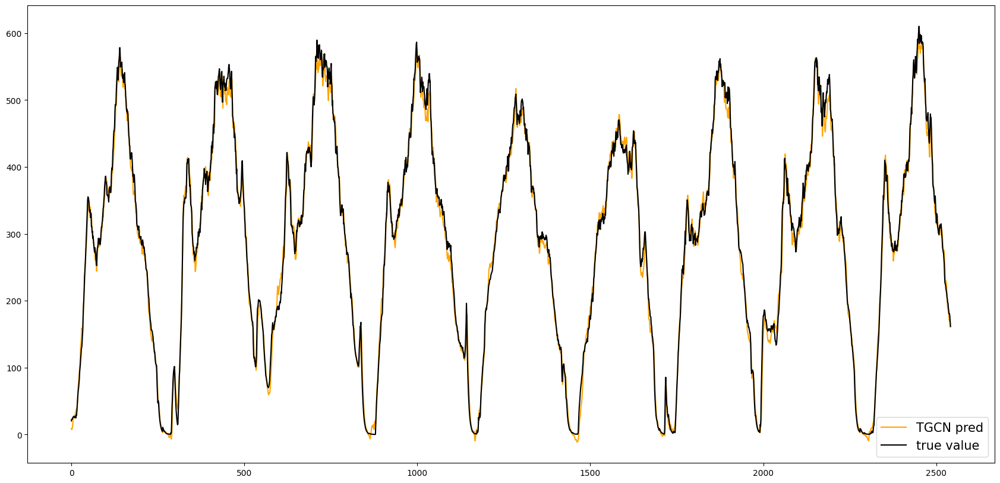

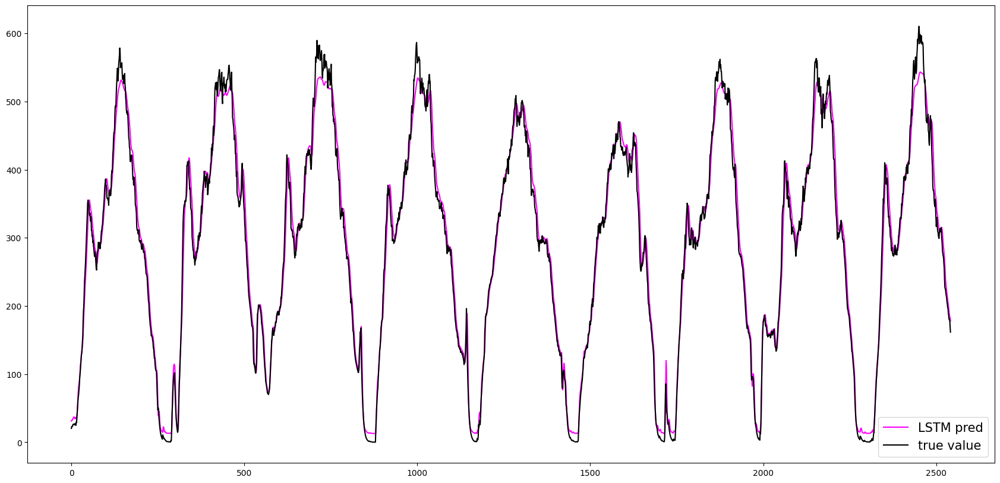

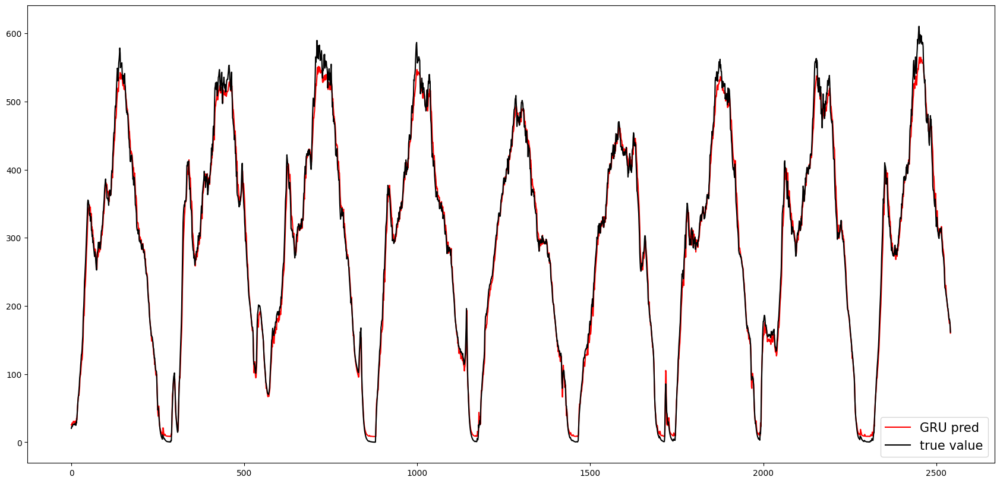

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 173,-,15.964653,21.004165,ERROR,6.391169,5.991150
LSTM Model captor 173,-,20.216728,27.432284,ERROR,6.966026,7.030253
GRU Model captor 173,-,24.078379,29.001745,ERROR,10.749628,11.309604


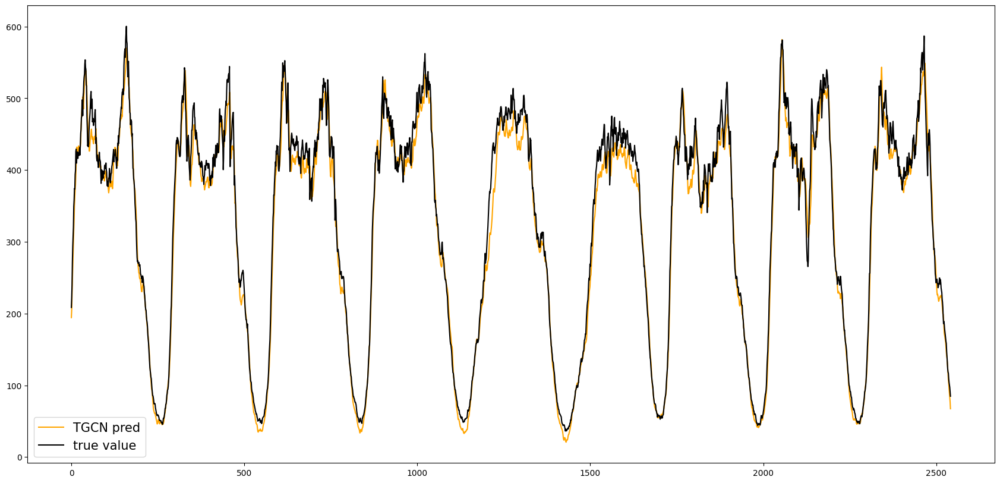

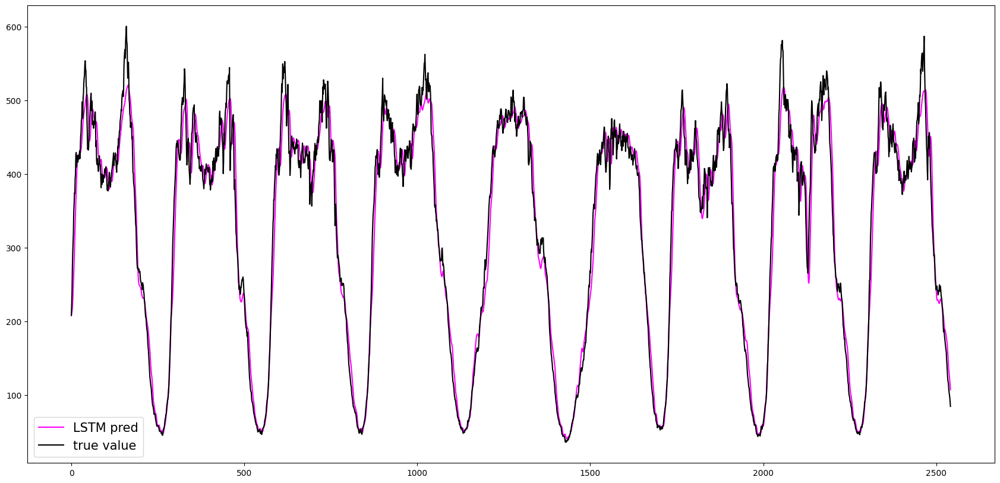

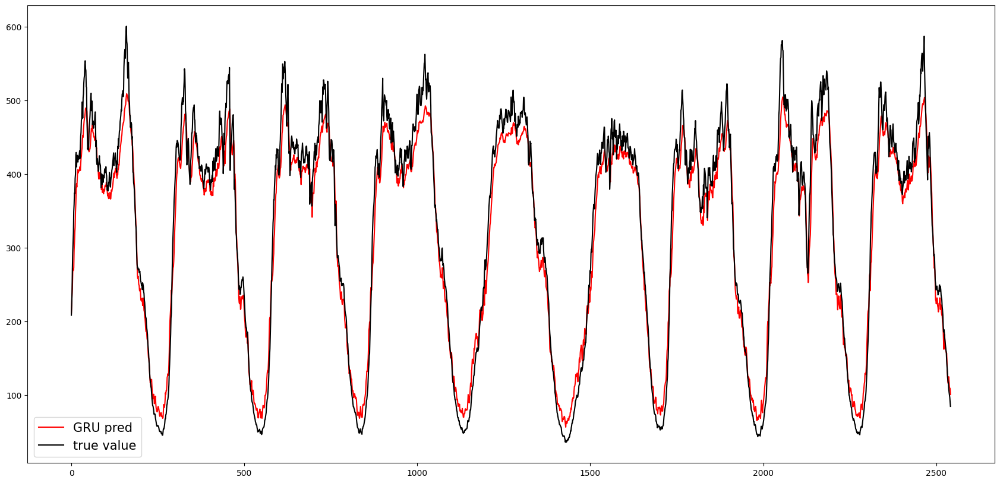

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 271,-,14.365688,20.642428,ERROR,4.922173,4.885317
LSTM Model captor 271,-,22.551684,27.620363,ERROR,9.486713,9.728273
GRU Model captor 271,-,23.214371,27.652854,ERROR,10.343478,10.873358


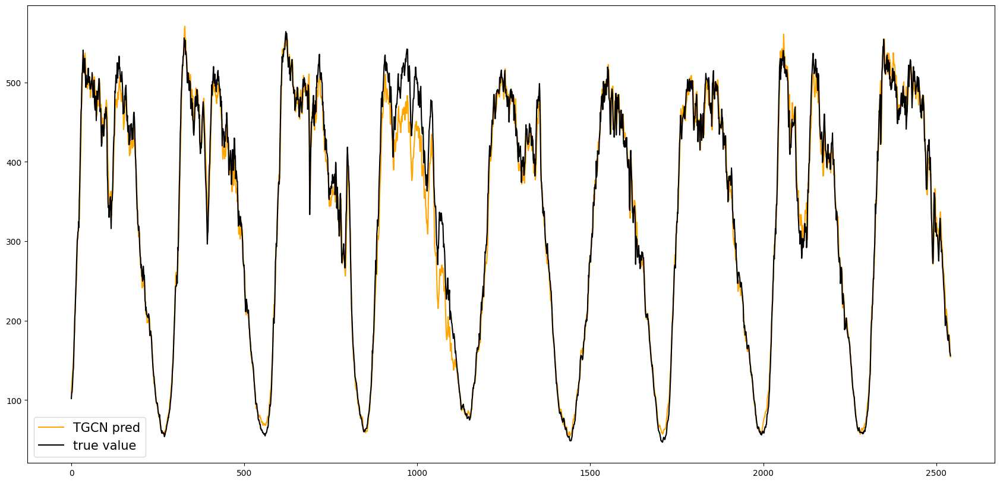

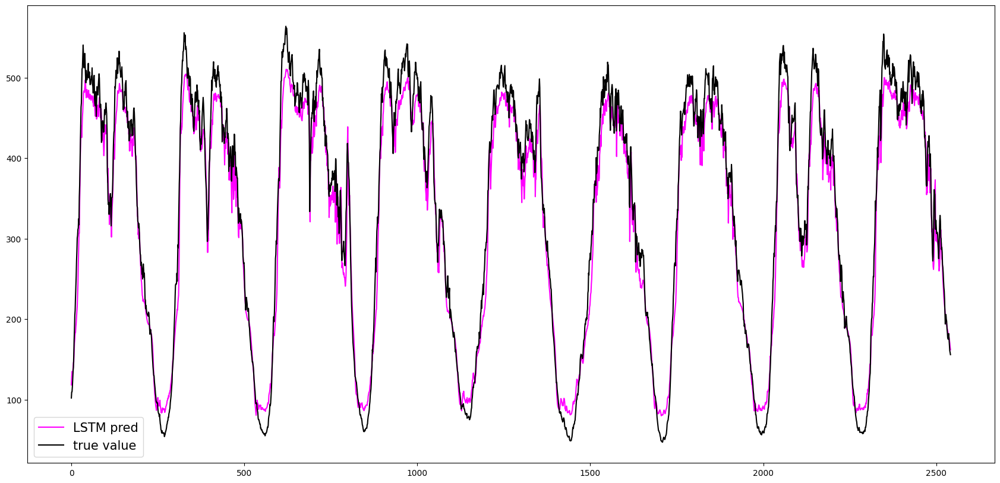

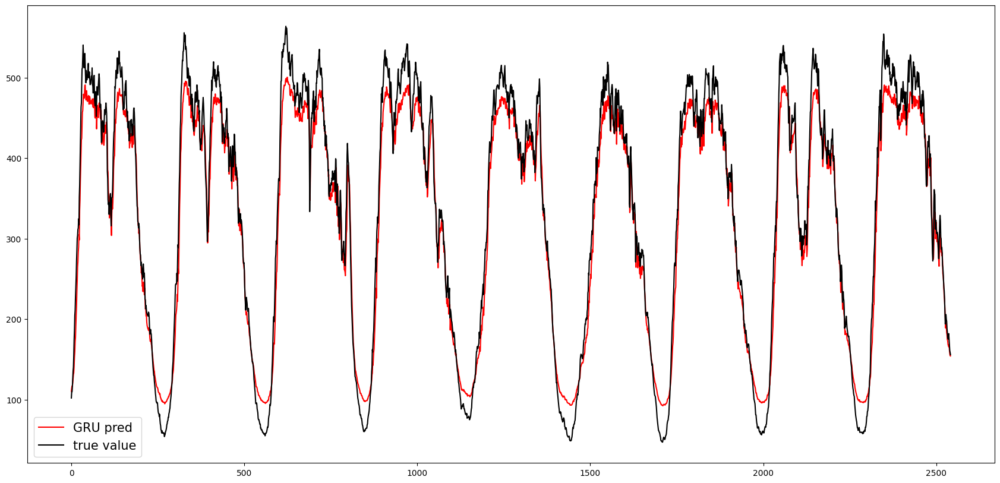

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 92,-,13.389718,17.912499,ERROR,4.957946,4.799366
LSTM Model captor 92,-,25.624271,34.974136,ERROR,12.858377,14.055509
GRU Model captor 92,-,26.597302,35.758168,ERROR,13.012739,14.138564


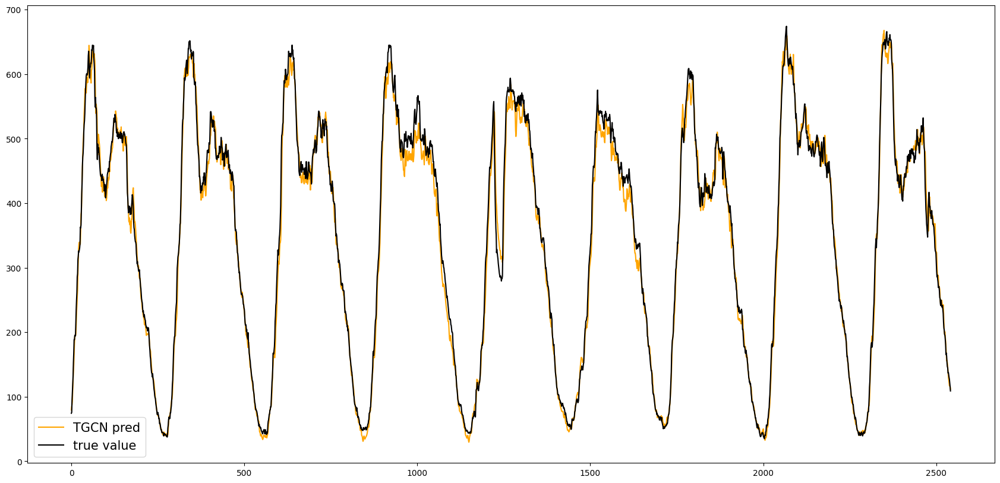

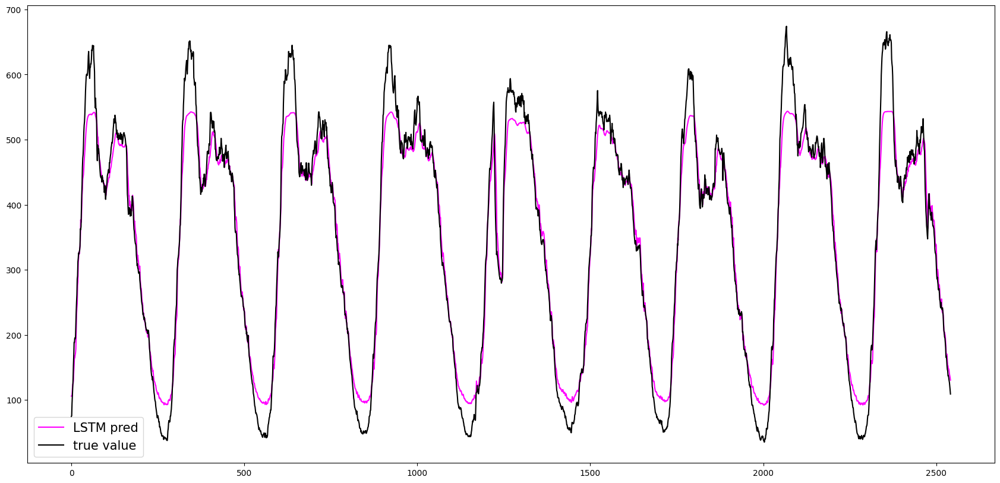

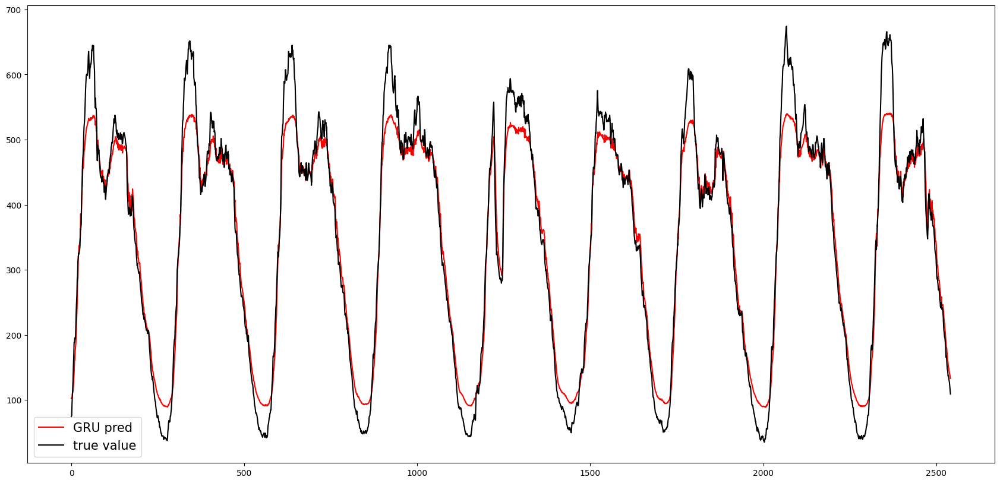

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 57,+,26.345259,44.081096,ERROR,23.462687,19.503471
LSTM Model captor 57,+,35.279439,49.847402,ERROR,28.033969,24.446212
GRU Model captor 57,+,23.078062,32.355524,ERROR,24.358502,20.386957


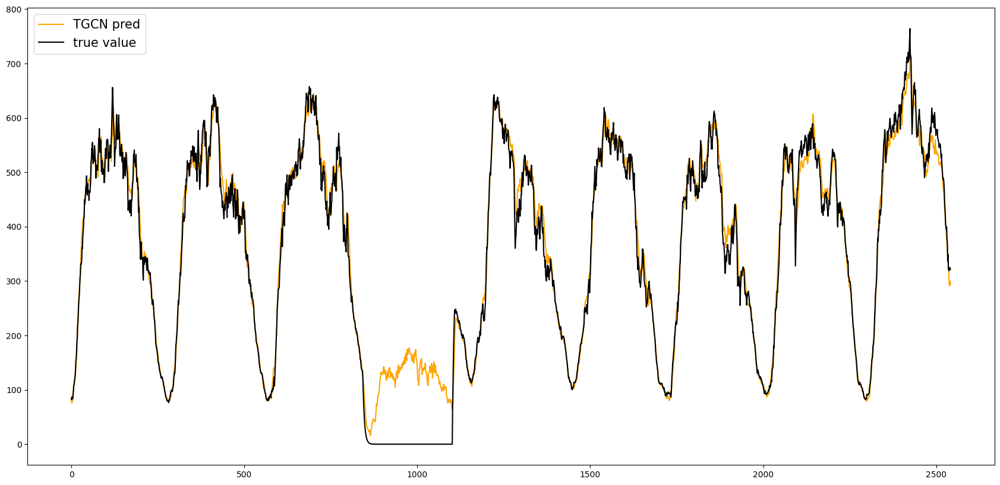

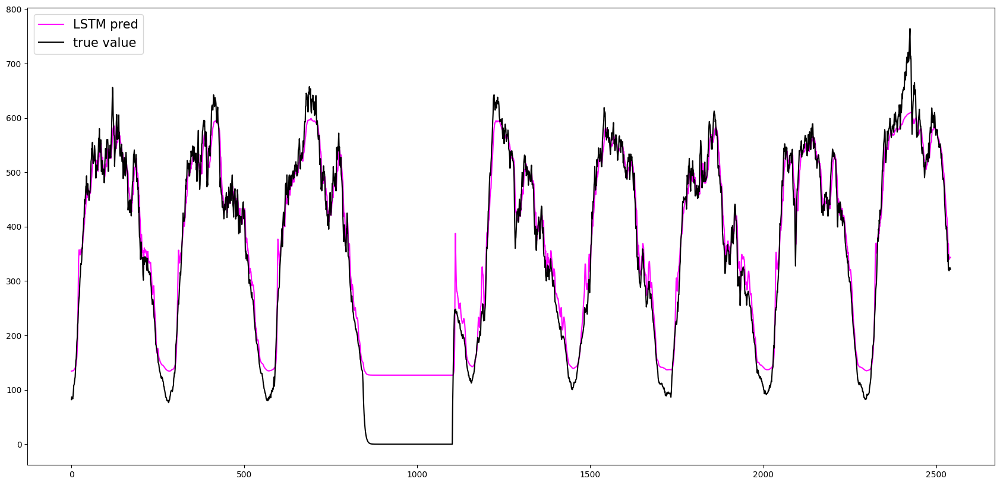

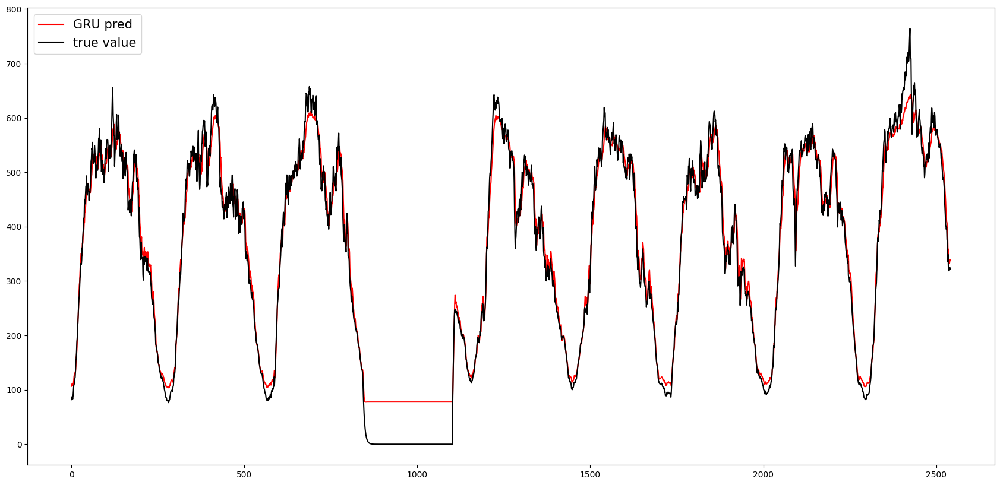

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 146,-,13.185804,17.448141,ERROR,3.700799,3.679273
LSTM Model captor 146,-,17.120147,22.557076,ERROR,4.792546,4.762257
GRU Model captor 146,-,20.720813,26.827380,ERROR,5.320199,5.176470


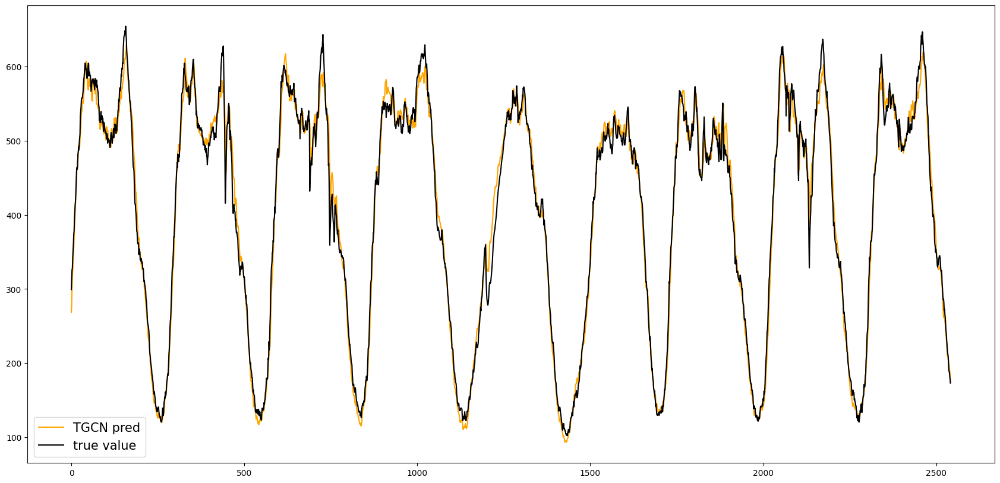

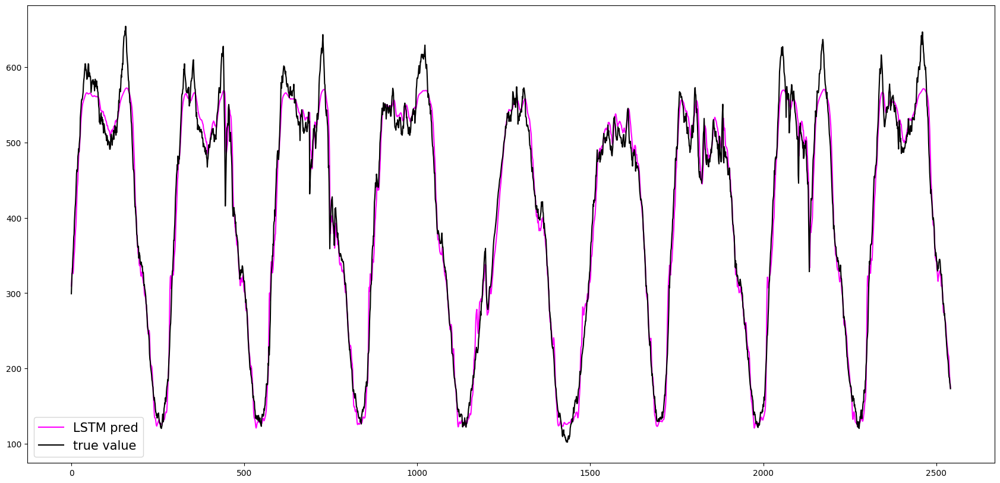

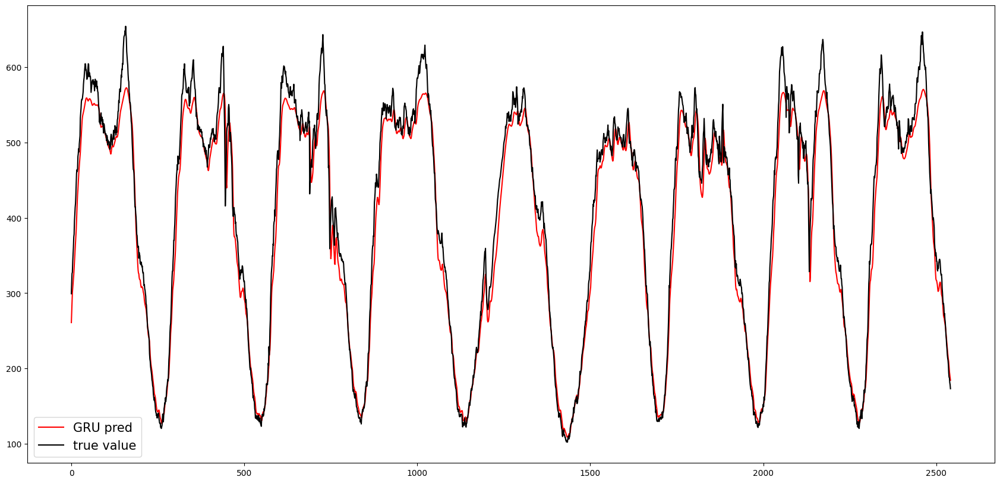

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 97,-,13.001119,18.000532,ERROR,3.290531,3.332905
LSTM Model captor 97,-,28.154240,36.456051,ERROR,7.376884,7.577195
GRU Model captor 97,-,26.662847,33.073212,ERROR,7.504236,7.775791


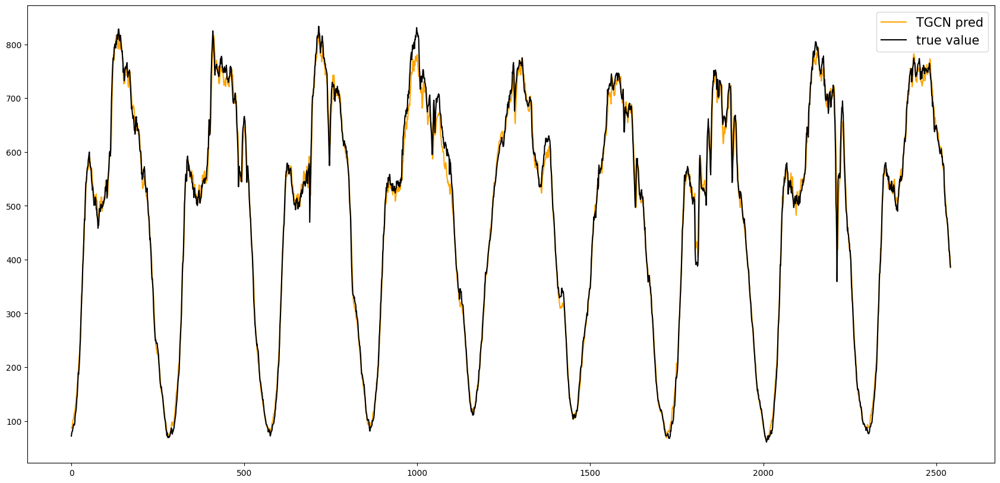

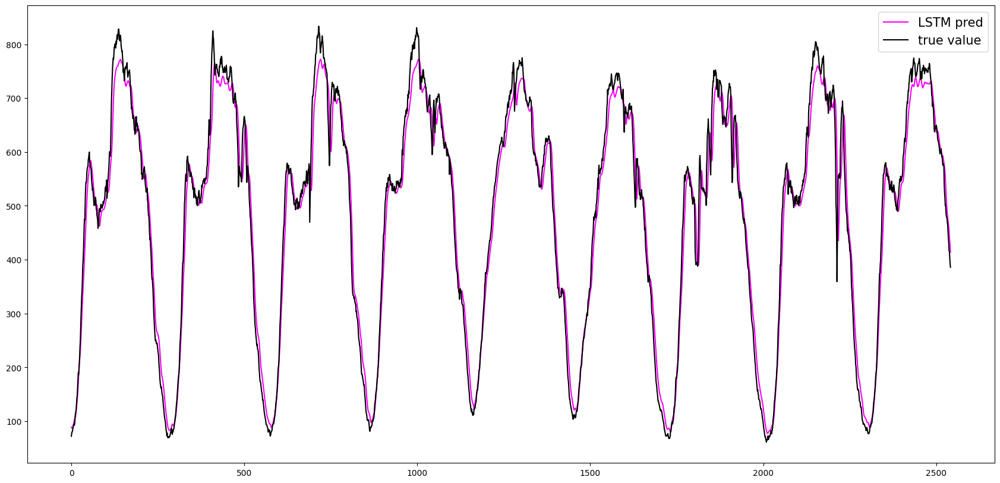

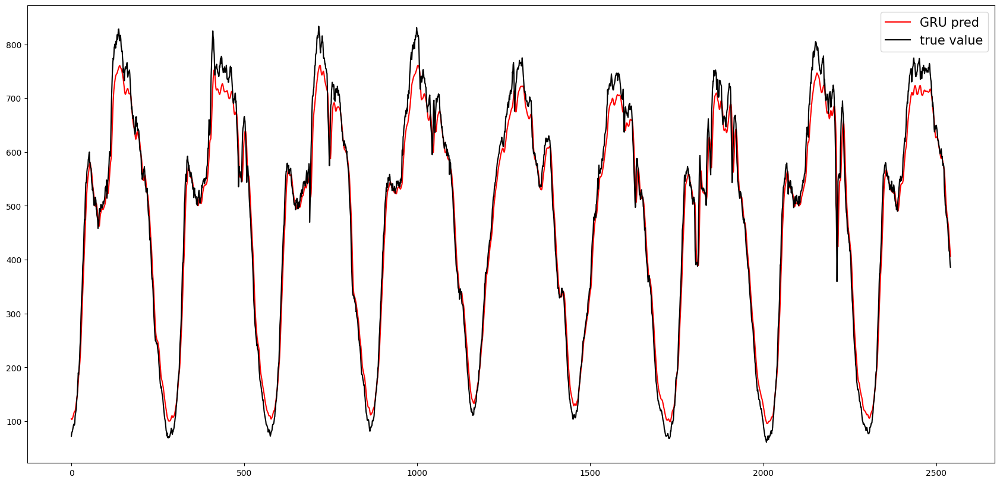

In [99]:
import matplotlib.pyplot as plt

######################################################################
# TGCN
######################################################################
# load best model
model_TGCN.load_state_dict(torch.load(f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_TGCN}/TGCN_model.pkl".format(input)))

# Make predictions
predictions_TGCN, actuals_TGCN = test_model_divide_by_max(model_TGCN, test_loader_TGCN, maximum)


for i in range(n_neighbors+1):
    
    # Save result for each captor
    temp = result_prediction(predictions_TGCN[:, i], actuals_TGCN[:, i])
    temp.append(f"TGCN Model captor {df_PeMS.columns[i]}")
    data = [temp]


######################################################################
# LSTM
######################################################################
    # load best model
    models_univaritate_LSTM[f"LSTMModel {i}"]["model"].load_state_dict(torch.load(f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_LSTM_univariate}/univariate_LSTM_model_{i}.pkl".format(input)))
    
    # Make predictions
    predictions_LSTM, actuals_LSTM = test_model_divide_by_max(models_univaritate_LSTM[f"LSTMModel {i}"]["model"], 
                                    models_univaritate_LSTM[f"LSTMModel {i}"]["test_loader"], 
                                    maximum)
    
    # Save result
    temp = result_prediction(predictions_LSTM, actuals_LSTM)

    temp.append(f"LSTM Model captor {df_PeMS.columns[i]}")
    data.append(temp)


######################################################################
# GRU
######################################################################
    # Load best model
    models_univaritate_GRU[f"GRUModel {i}"]["model"].load_state_dict(torch.load(f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_univaritate_GRU}/univariate_GRU_model_{i}.pkl".format(input)))
    predictions_GRU, actuals_GRU = test_model_divide_by_max(models_univaritate_GRU[f"GRUModel {i}"]["model"], 
                                    models_univaritate_GRU[f"GRUModel {i}"]["test_loader"],
                                    maximum)
    
    # Make predictions
    temp = result_prediction(predictions_GRU, actuals_GRU)

    # Save results
    temp.append(f"GRU Model captor {df_PeMS.columns[i]}")
    data.append(temp)


######################################################################
# Dataframe
######################################################################

    df = pd.DataFrame(data, columns=['Signe error', 'MAE', 'RMSE', 'MAPE', 'SMAPE', 'MAAPE', "Captor"])

    # Définir le mois comme index du DataFrame
    df.set_index('Captor', inplace=True)

    pd.set_option('display.max_columns', None)
    pd.set_option('display.max_rows', None)
    pd.set_option('display.width', None)

    min_val = df['MAAPE'].min()
    max_val = df['MAAPE'].max()
    #df = df.style.apply(highlight_col, axis=0, min_val=min_val)
    df = df.style.apply(highlight_rows, axis=1, min_val=min_val, max_val=max_val)
    display(df)


######################################################################
# Plots
######################################################################
    plt.figure(figsize=(21, 10))
    plt.plot(predictions_TGCN[:, i], color="orange", label="TGCN pred")
    plt.plot(actuals_LSTM, color="black", label="true value")
    plt.legend(fontsize=15)
    plt.show()
    
    plt.figure(figsize=(21, 10))
    plt.plot(predictions_LSTM, color="magenta", label="LSTM pred")
    plt.plot(actuals_LSTM, color="black", label="true value")
    plt.legend(fontsize=15)
    plt.show()
    
    plt.figure(figsize=(21, 10))
    plt.plot(predictions_GRU, color="red", label="GRU pred" )
    plt.plot(actuals_LSTM, color="black", label="true value")
    plt.legend(fontsize=15)
    plt.show()


## Multivariate

### LSTM

In [94]:
print("LSTMModel")
train_loader, val_loader, test_loader = createLoaders(pd.DataFrame(df_PeMS), window_size=_window_size, stride=_stride)
models_multivariate_LSTM = {
                                                "model": LSTMModel(len(df_PeMS.columns), 32, len(df_PeMS.columns)),
                                                "train_loader": train_loader,
                                                "val_loader": val_loader,
                                                "test_loader": test_loader
    }

LSTMModel


In [95]:
num_epochs_LSTM_multivariate = 200

# _, valid_losses, train_losses = train_model(models_multivariate_LSTM["model"], 
#             models_multivariate_LSTM["train_loader"], 
#             models_multivariate_LSTM["val_loader"], 
#             f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_LSTM_multivariate}/multivariate_LSTM_model.pkl", num_epochs=num_epochs_LSTM_multivariate, remove=False)

# plt.figure(figsize=(25, 9))
# plt.title(f"LSTM multivariate TRAIN LOSSES")
# plt.plot(train_losses, label="train_losses")
# plt.legend(fontsize=12)
# plt.show()
# plt.figure(figsize=(25, 9))
# plt.title(f"LSTM multivariate VALID LOSSES")
# plt.plot(valid_losses, label="valid_losses")
# plt.legend(fontsize=12)
# plt.show()

### GRU

In [96]:
print("GRUModel")
train_loader, val_loader, test_loader = createLoaders(pd.DataFrame(df_PeMS), window_size=_window_size, stride=_stride)
models_multivariate_GRU = {
                                                "model": GRUModel(len(df_PeMS.columns), 32, len(df_PeMS.columns)),
                                                "train_loader": train_loader,
                                                "val_loader": val_loader,
                                                "test_loader": test_loader
    }

GRUModel


In [97]:
num_epochs_GRU_multivariate = 200

# _, valid_losses, train_losses = train_model(models_multivariate_GRU["model"], 
#                 models_multivariate_GRU["train_loader"], 
#                 models_multivariate_GRU["val_loader"], 
#                 f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_GRU_multivariate}/multivariate_GRU_model.pkl", num_epochs=num_epochs_GRU_multivariate, remove=False)
# plt.figure(figsize=(25, 9))
# plt.title(f"GRU multivariate TRAIN LOSSES")
# plt.plot(train_losses, label="train_losses")
# plt.legend(fontsize=12)
# plt.show()
# plt.figure(figsize=(25, 9))
# plt.title(f"GRU multivariate VALID LOSSES")
# plt.plot(valid_losses, label="valid_losses")
# plt.legend(fontsize=12)
# plt.show()

## Results Multivariate vs Multivariate (TGCN VS LSTM - GRU)

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 68,-,15.230737,20.994156,ERROR,17.004402,15.961273
LSTM Model captor 68,-,7.355115,10.279059,ERROR,7.603496,7.625033
GRU Model captor 68,+,6.418748,9.286259,ERROR,6.449223,6.599075


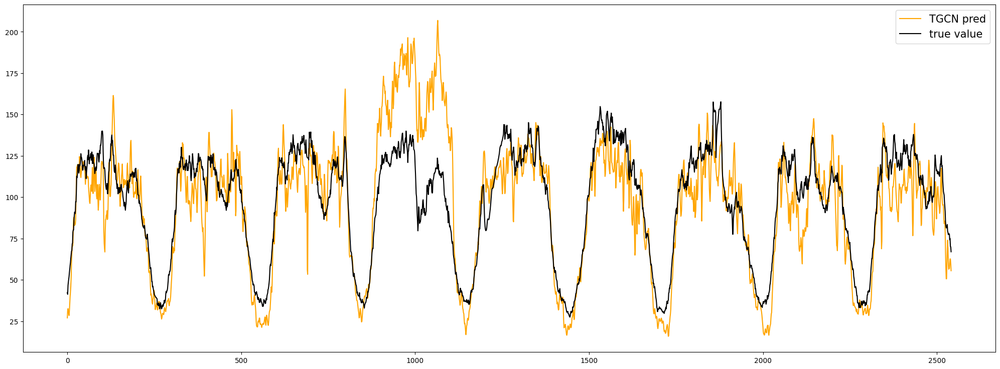

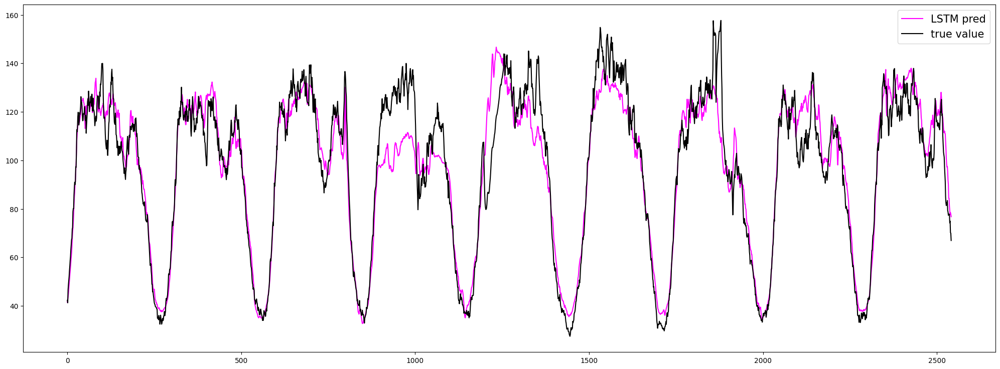

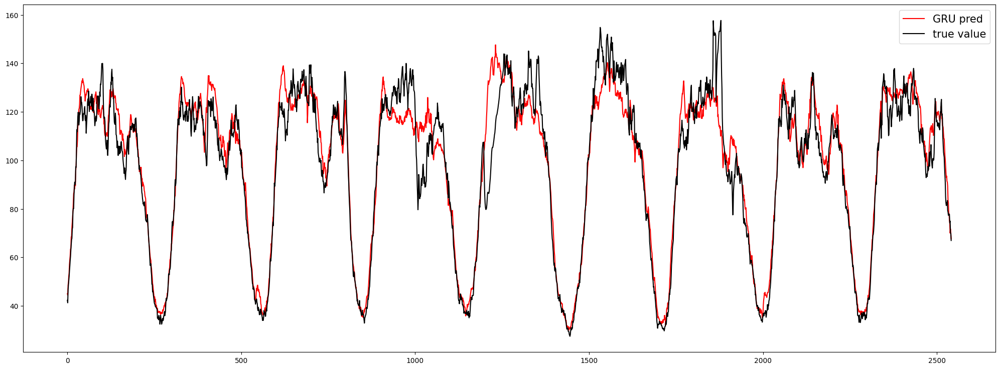

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 62,-,7.573504,9.879065,ERROR,8.347157,8.189107
LSTM Model captor 62,+,11.487196,17.695703,ERROR,8.880384,9.214869
GRU Model captor 62,-,10.274899,15.269271,ERROR,9.807113,9.362410


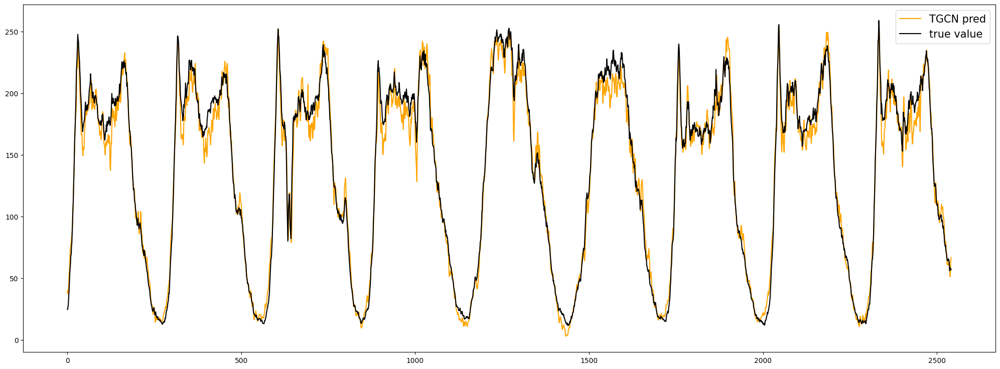

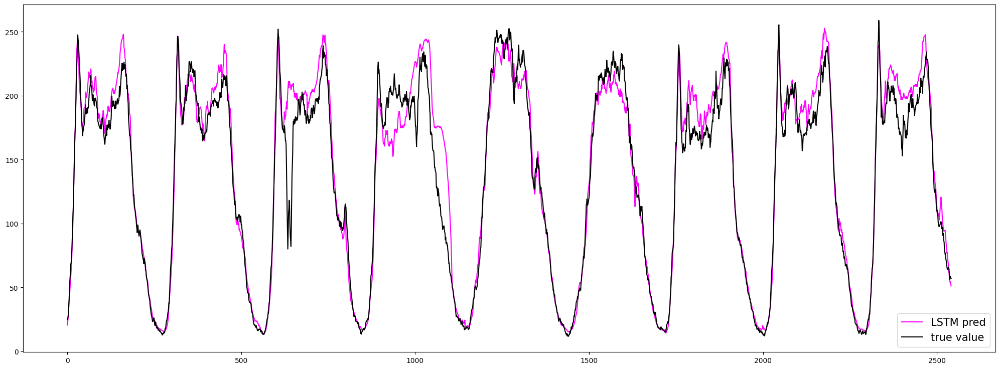

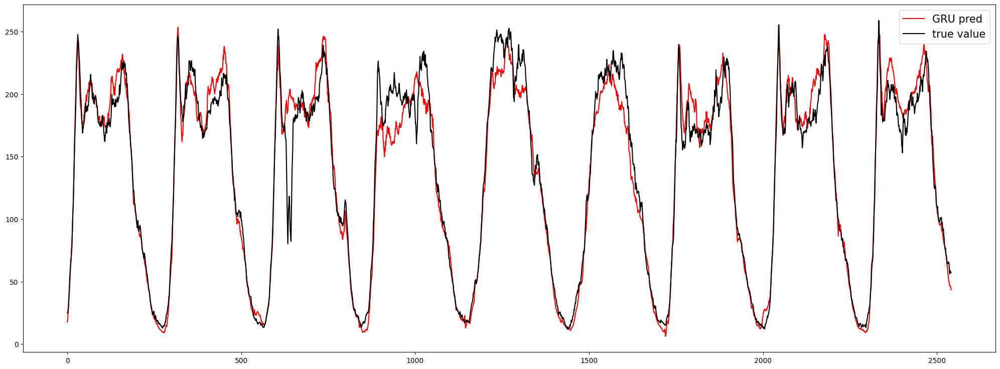

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 104,-,10.864675,14.363090,ERROR,22.341611,15.617680
LSTM Model captor 104,+,10.757049,16.091784,ERROR,12.100745,12.560280
GRU Model captor 104,+,10.003061,12.457790,ERROR,13.785931,15.157404


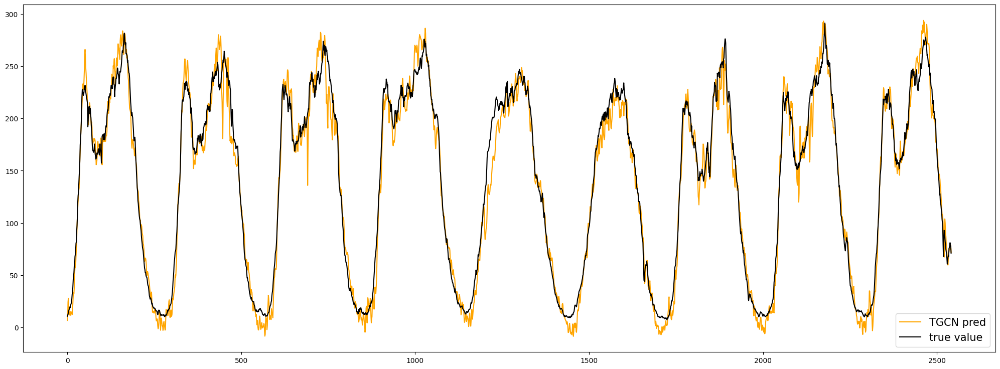

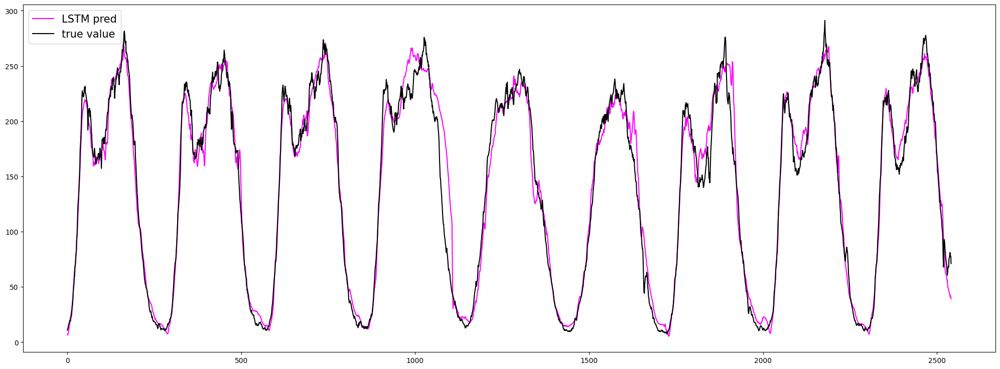

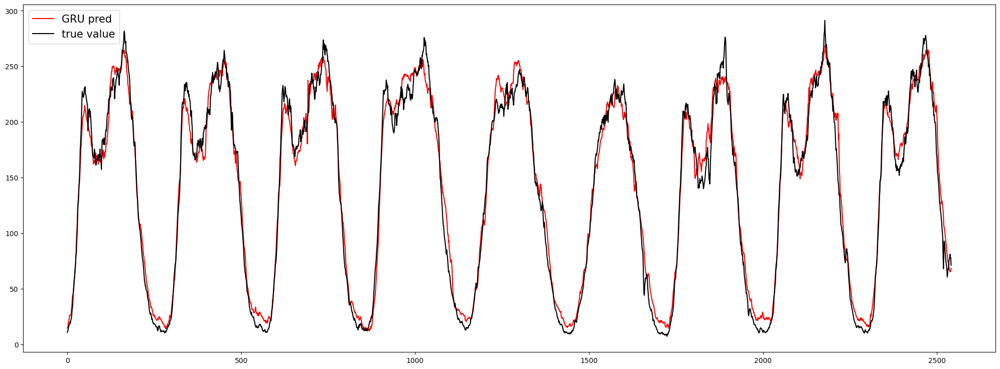

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 242,+,12.153047,15.516903,ERROR,35.026877,31.015119
LSTM Model captor 242,+,10.267793,15.606184,ERROR,28.471633,25.846989
GRU Model captor 242,+,9.077944,12.351686,ERROR,28.630613,23.839230


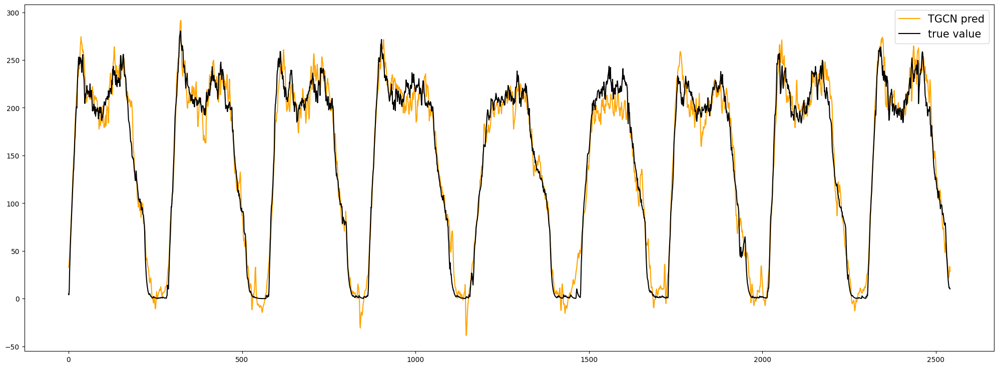

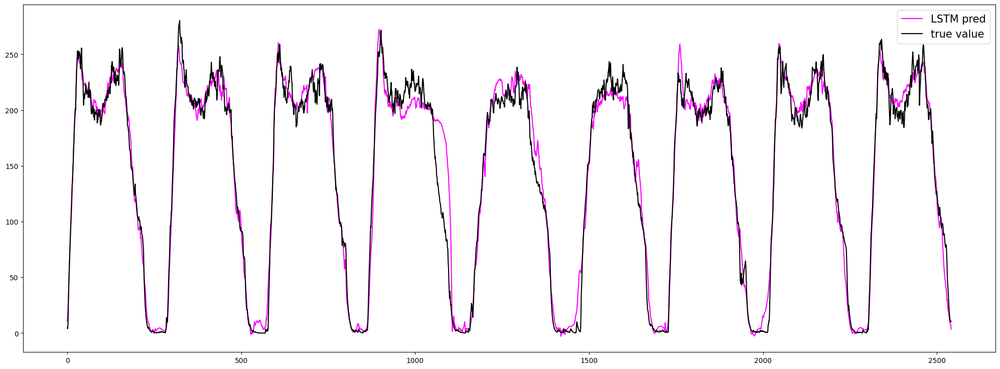

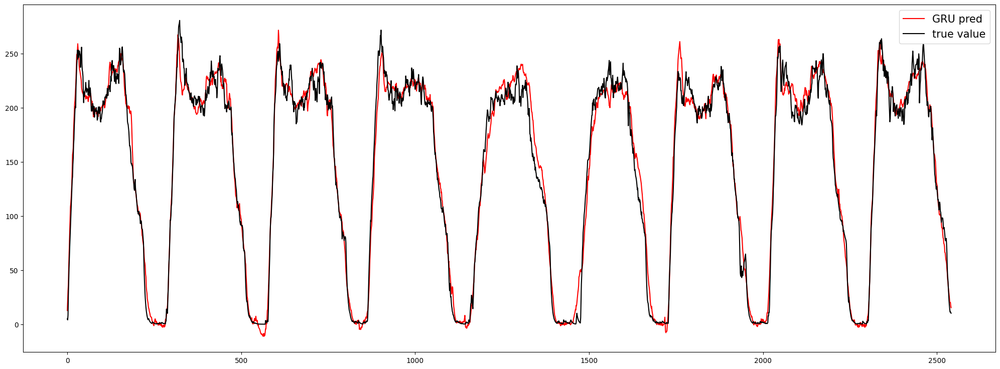

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 243,-,11.675503,14.972247,ERROR,10.854630,9.699721
LSTM Model captor 243,+,9.872890,15.681346,ERROR,6.484870,6.611684
GRU Model captor 243,-,9.779879,14.361278,ERROR,7.558374,7.334239


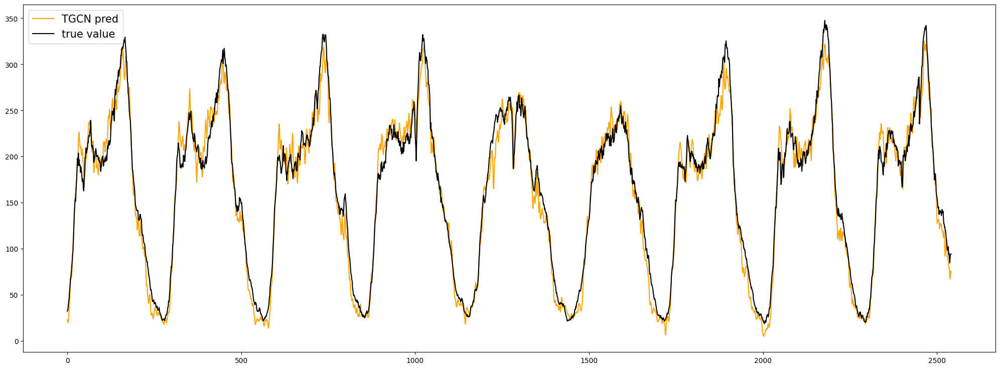

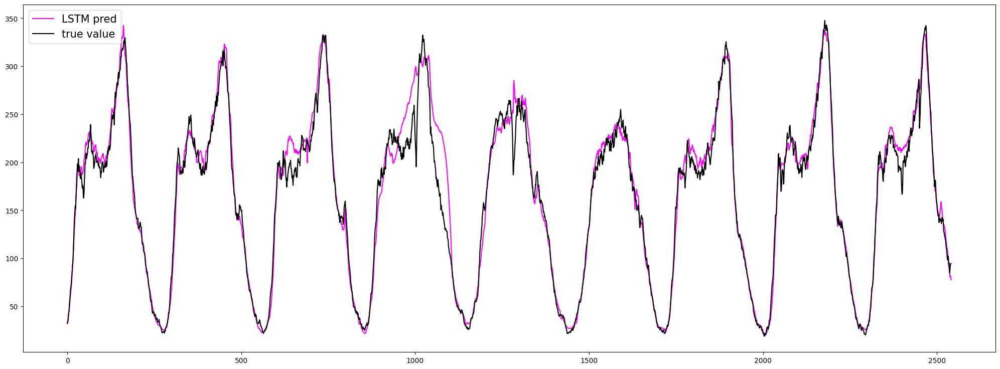

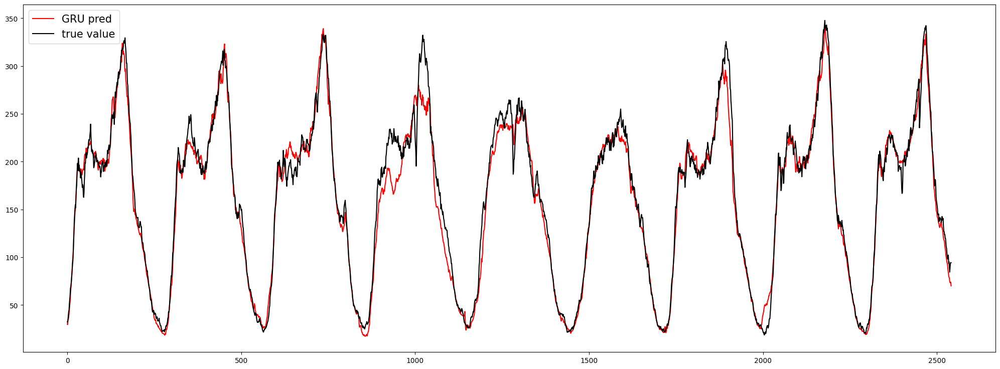

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 117,-,13.562869,17.753652,ERROR,7.855581,8.119953
LSTM Model captor 117,+,18.946628,27.180953,ERROR,9.119645,9.327632
GRU Model captor 117,-,17.729491,30.922678,ERROR,8.936766,8.457487


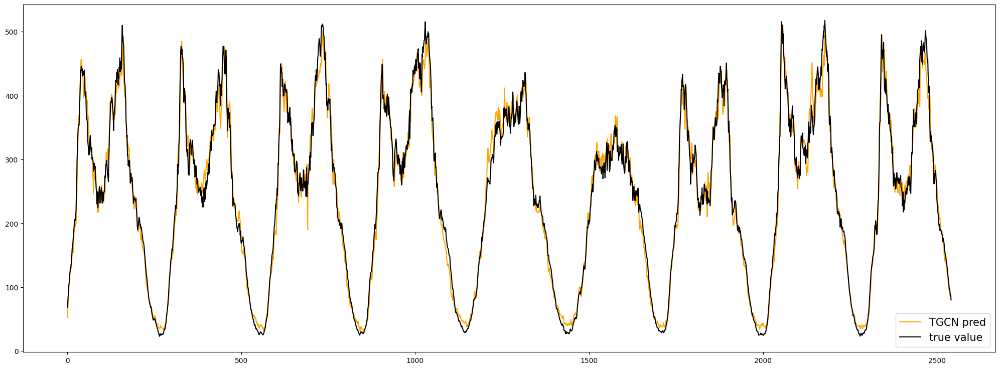

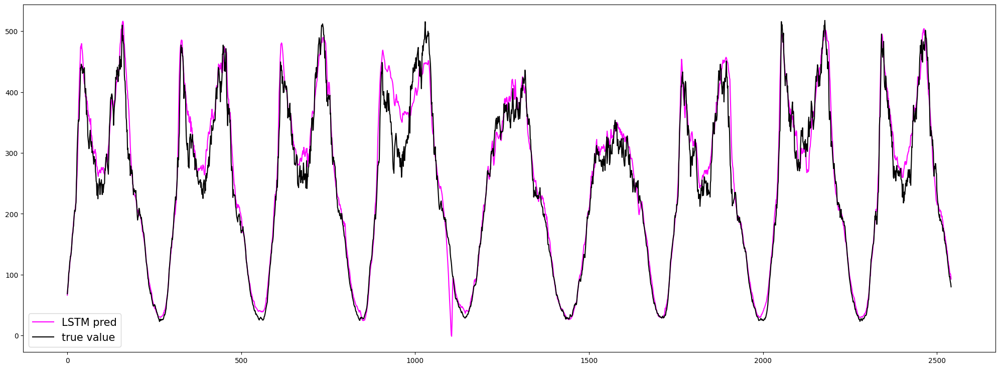

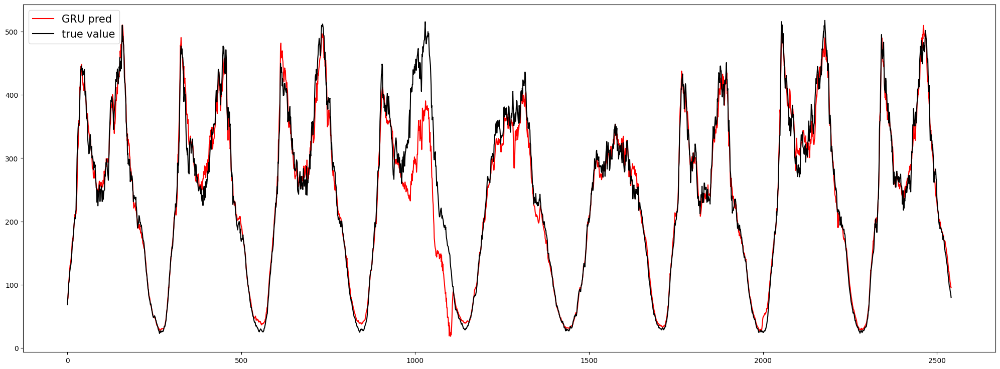

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 28,-,18.941297,30.177707,ERROR,8.279173,7.777560
LSTM Model captor 28,+,16.747322,22.615519,ERROR,7.901327,8.063486
GRU Model captor 28,+,18.420073,27.130387,ERROR,8.836070,8.815638


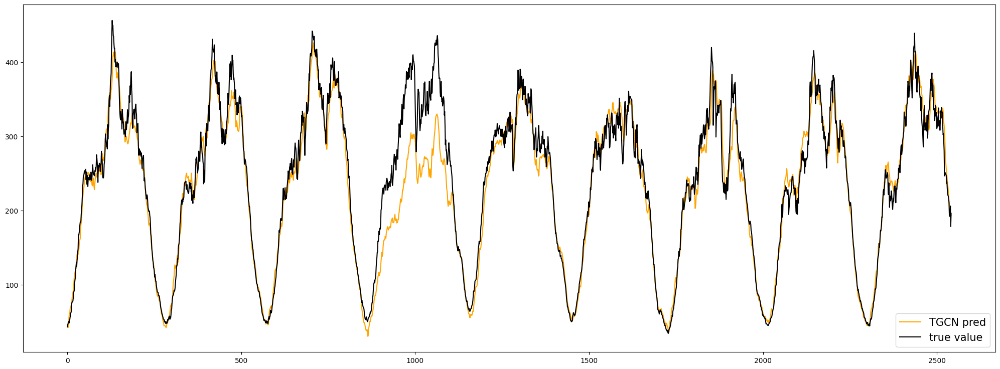

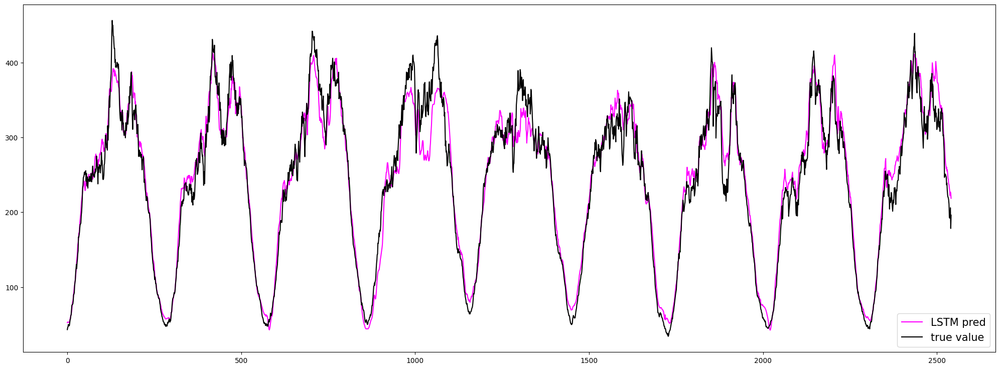

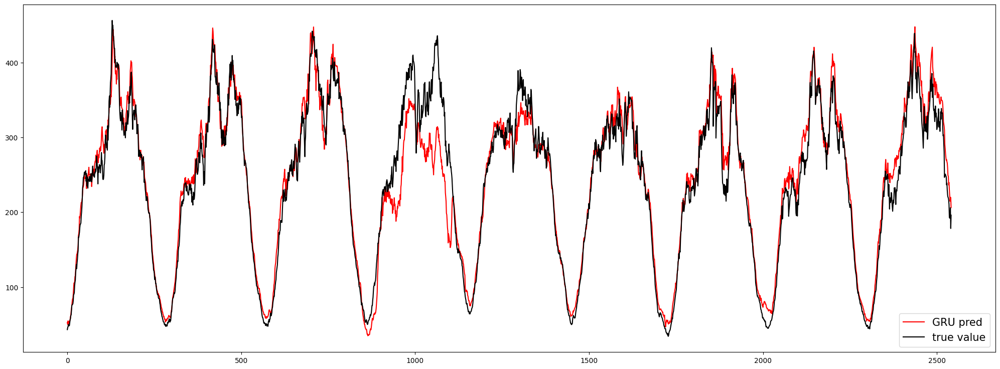

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 170,-,14.378911,19.978670,ERROR,8.416238,8.241223
LSTM Model captor 170,-,18.098594,27.716546,ERROR,9.135036,8.843756
GRU Model captor 170,-,10.170239,15.205535,ERROR,5.305384,5.231235


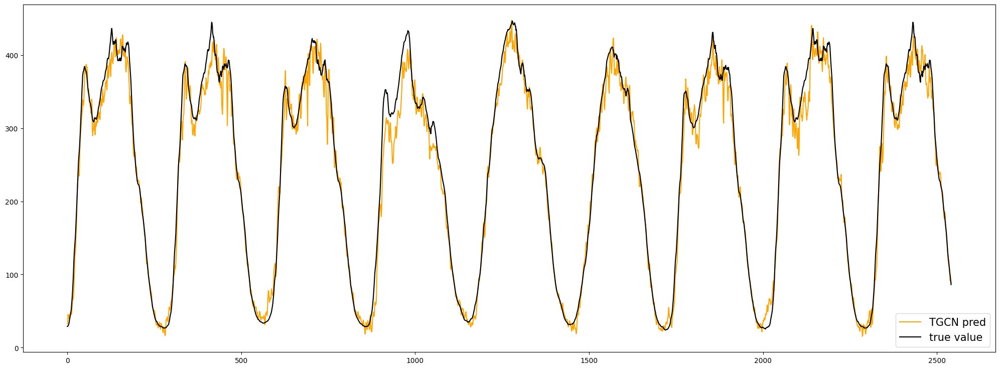

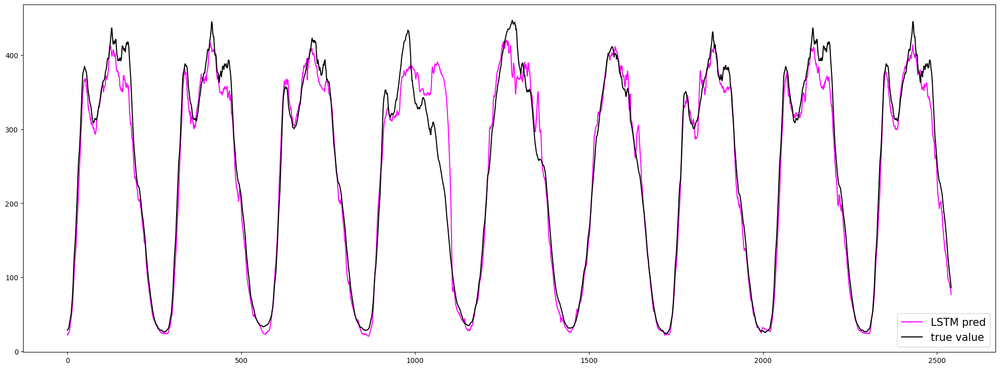

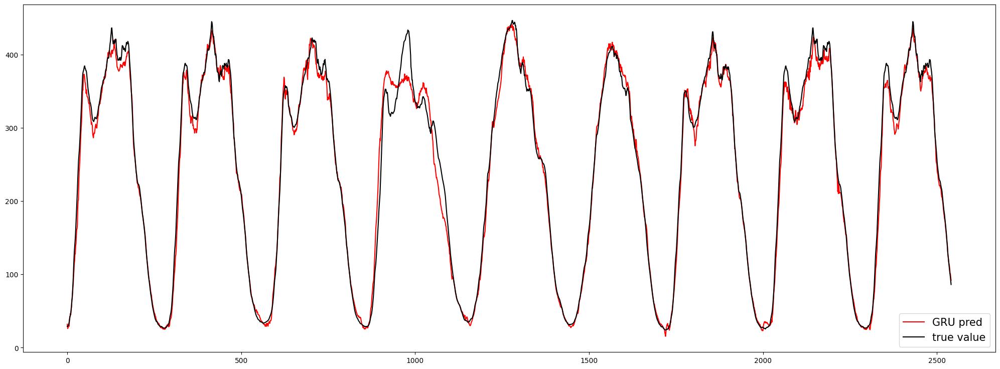

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 0,-,12.987837,16.944540,ERROR,6.949282,6.641163
LSTM Model captor 0,+,17.407369,24.078006,ERROR,7.972212,8.124943
GRU Model captor 0,-,13.974230,19.269513,ERROR,6.180624,6.123441


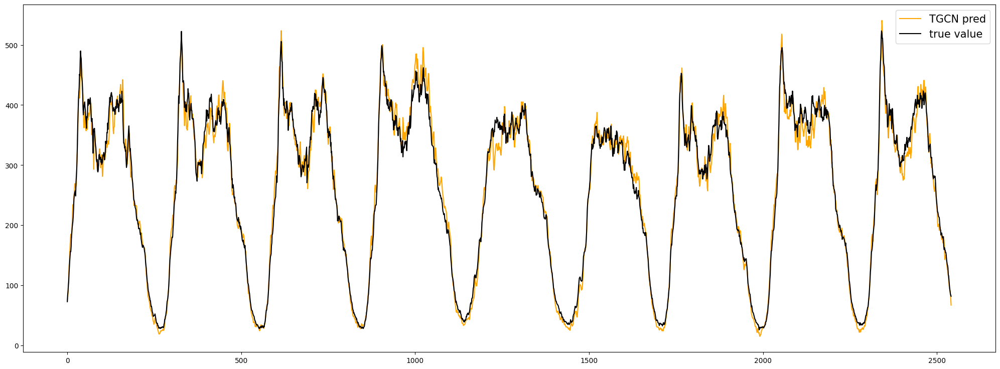

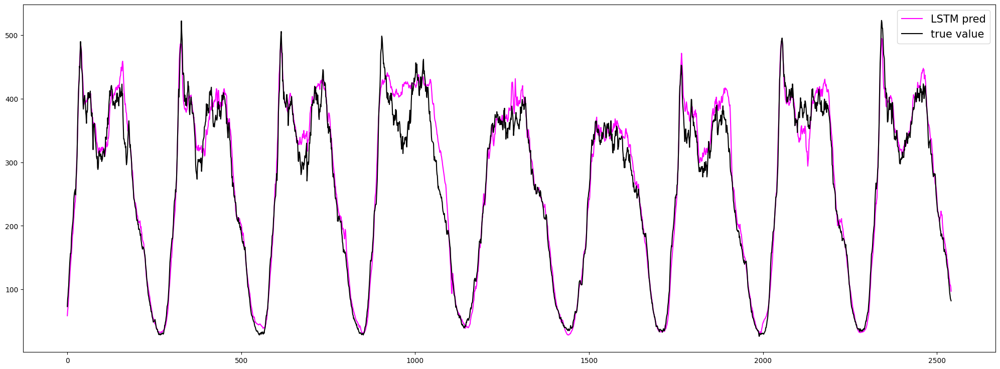

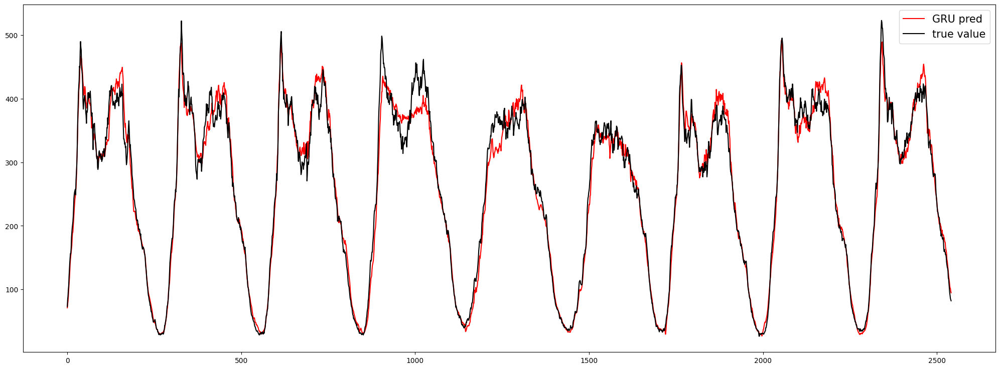

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 18,-,10.413811,13.539720,ERROR,13.902083,11.575239
LSTM Model captor 18,-,17.230542,27.322332,ERROR,16.555393,14.893909
GRU Model captor 18,+,15.482160,24.607107,ERROR,14.694507,14.029793


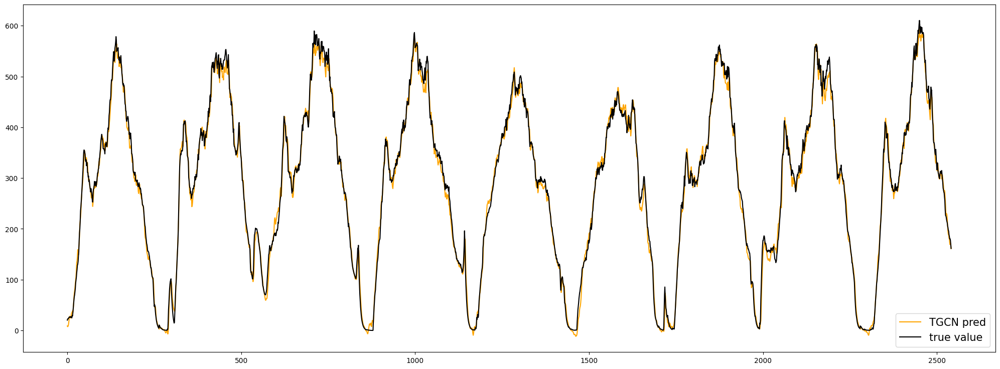

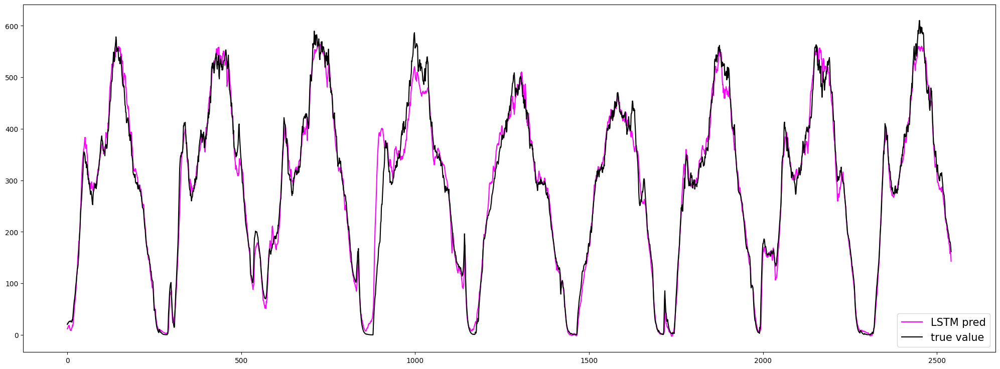

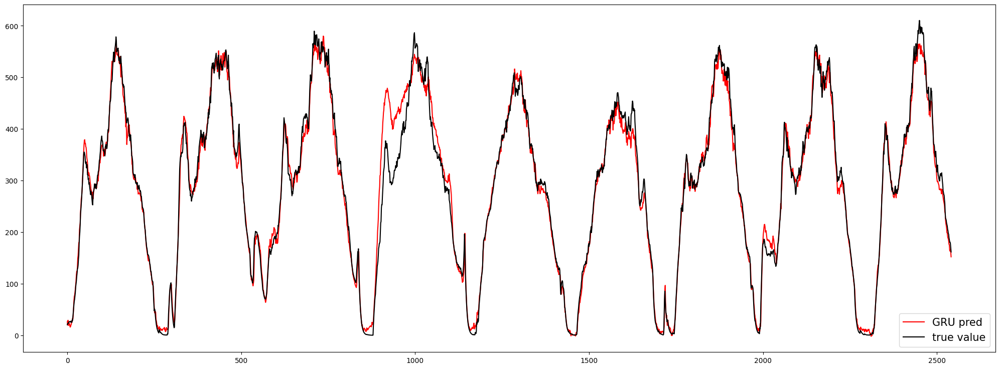

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 173,-,15.964653,21.004165,ERROR,6.391169,5.991150
LSTM Model captor 173,+,19.728247,32.158711,ERROR,6.647971,6.914236
GRU Model captor 173,+,13.692342,19.163841,ERROR,5.268469,5.424080


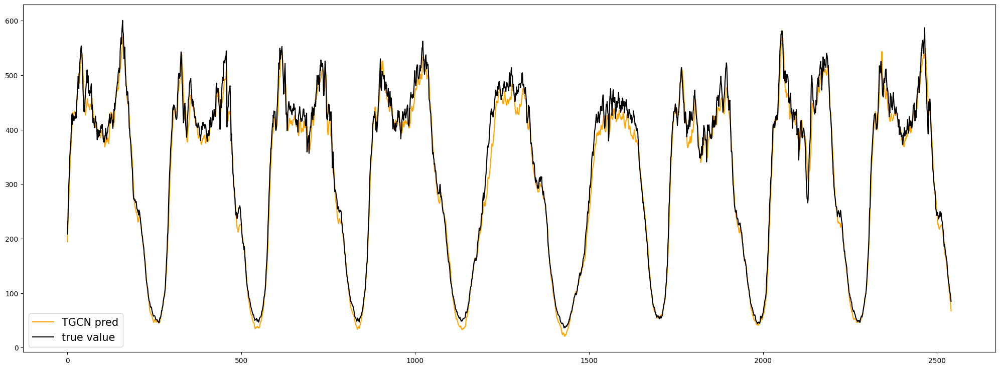

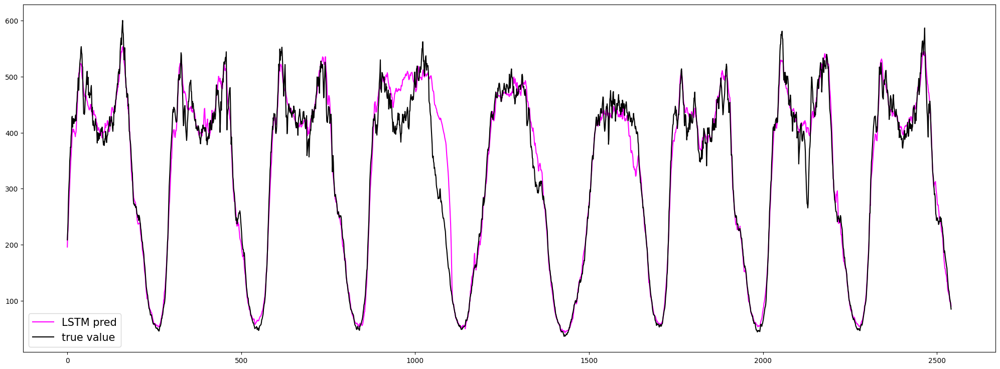

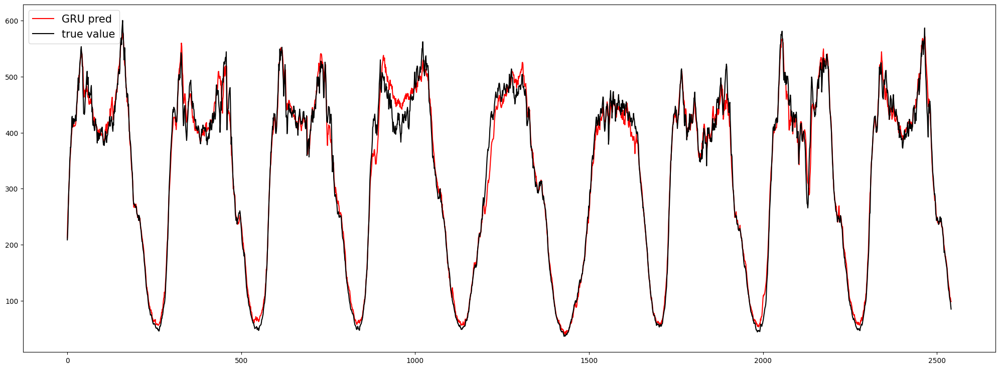

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 271,-,14.365688,20.642428,ERROR,4.922173,4.885317
LSTM Model captor 271,-,28.467864,42.428590,ERROR,9.089539,9.150299
GRU Model captor 271,+,14.792163,22.095336,ERROR,5.065478,5.096132


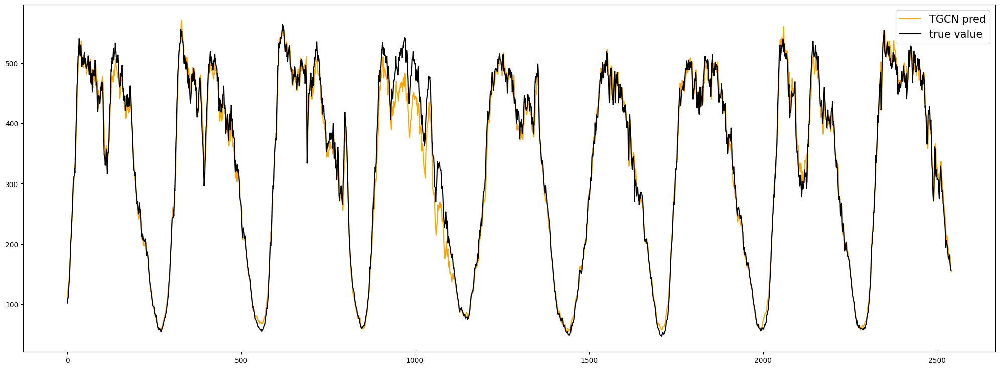

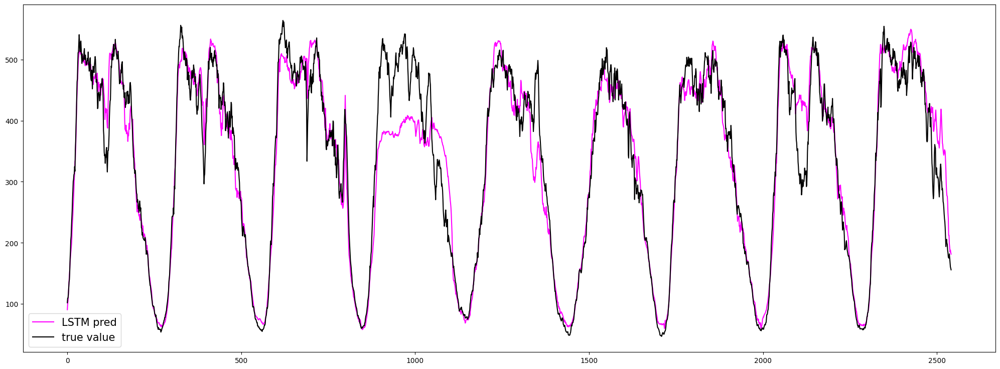

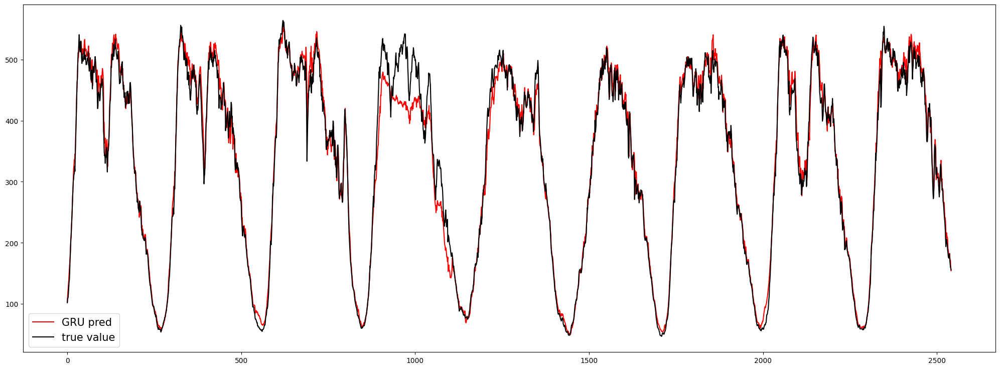

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 92,-,13.389718,17.912499,ERROR,4.957946,4.799366
LSTM Model captor 92,+,24.066916,32.994797,ERROR,10.429181,11.204962
GRU Model captor 92,+,16.981706,20.737200,ERROR,8.834017,9.623252


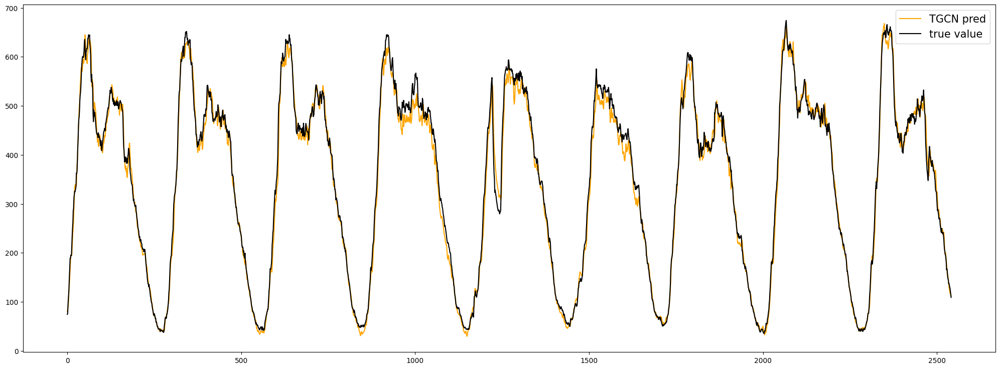

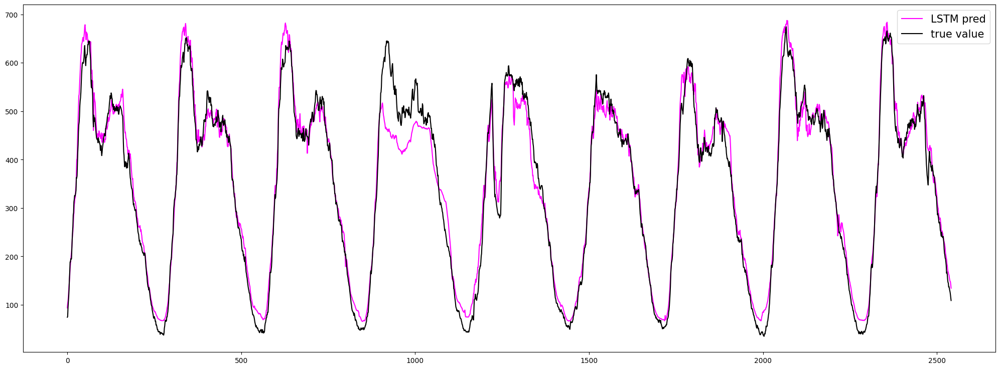

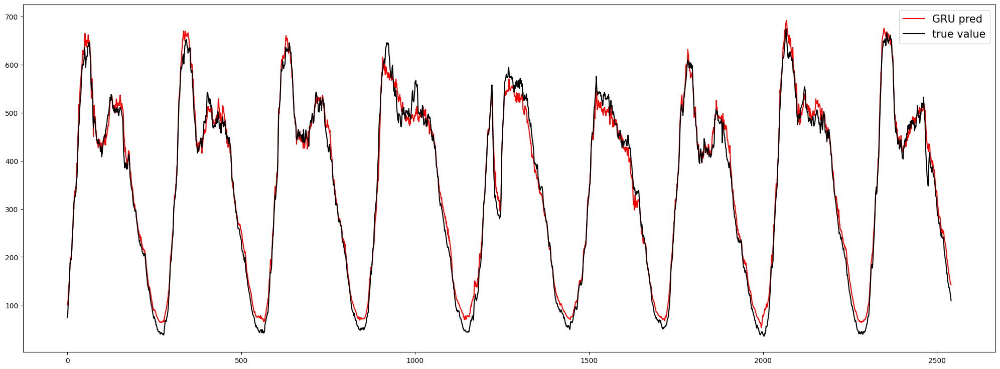

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 57,+,26.345259,44.081096,ERROR,23.462687,19.503471
LSTM Model captor 57,+,43.154196,89.684570,ERROR,24.428258,20.370155
GRU Model captor 57,+,35.038571,70.856425,ERROR,23.808158,19.705870


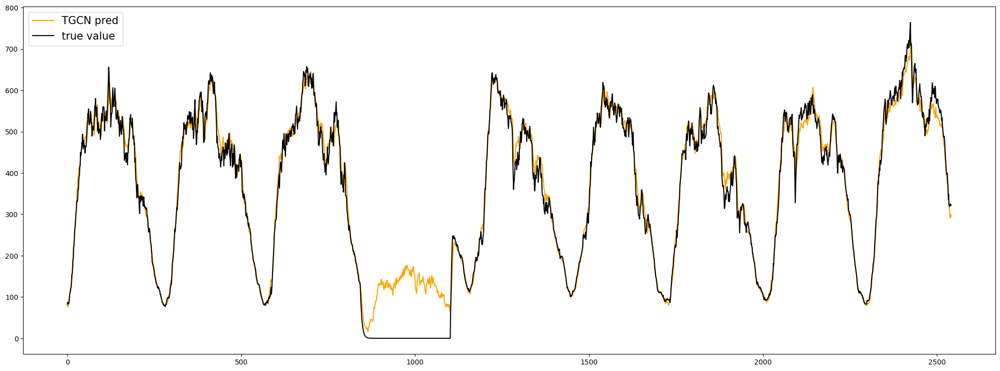

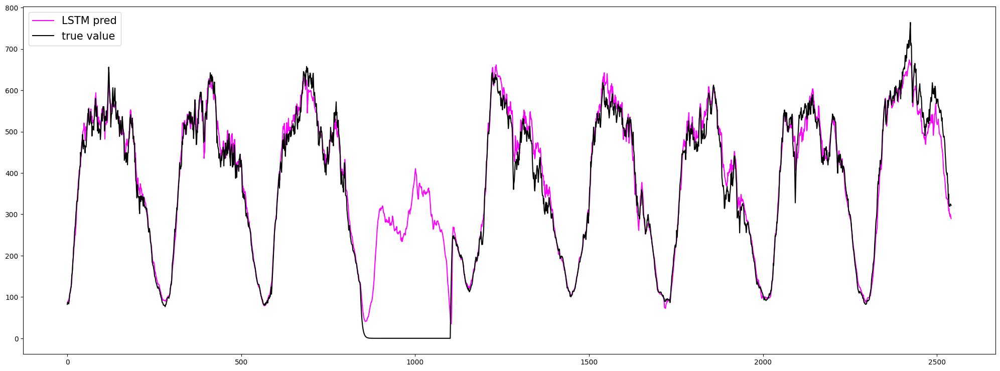

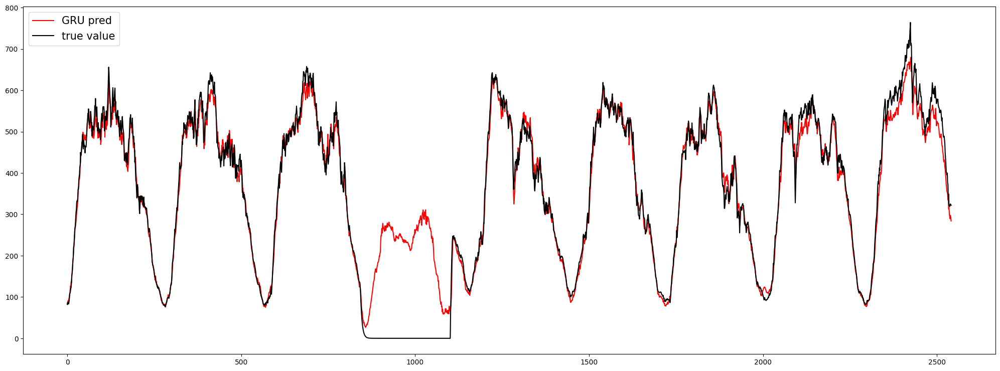

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 146,-,13.185804,17.448141,ERROR,3.700799,3.679273
LSTM Model captor 146,+,23.332016,34.832883,ERROR,6.059494,6.230627
GRU Model captor 146,+,14.836063,21.872635,ERROR,3.969507,4.084486


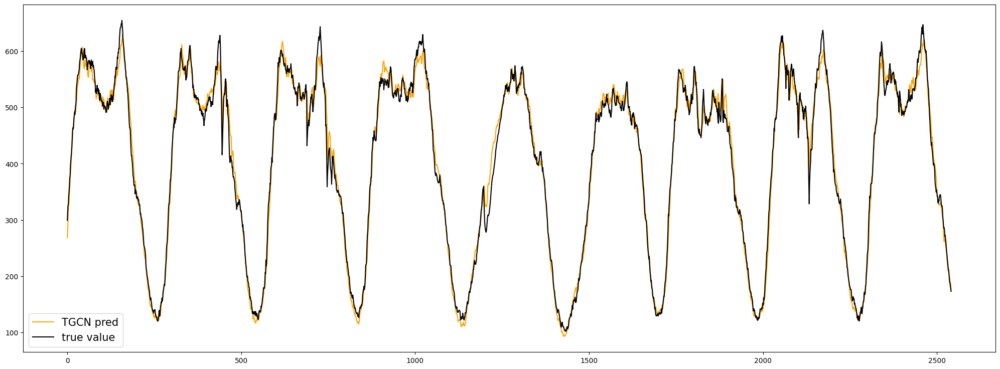

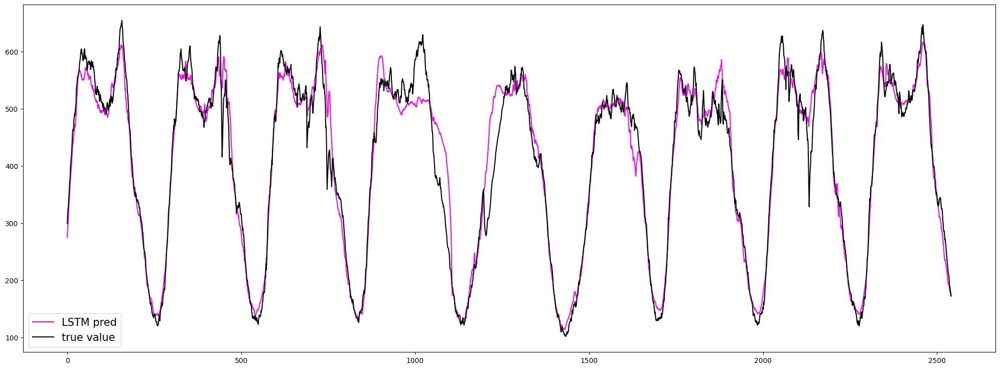

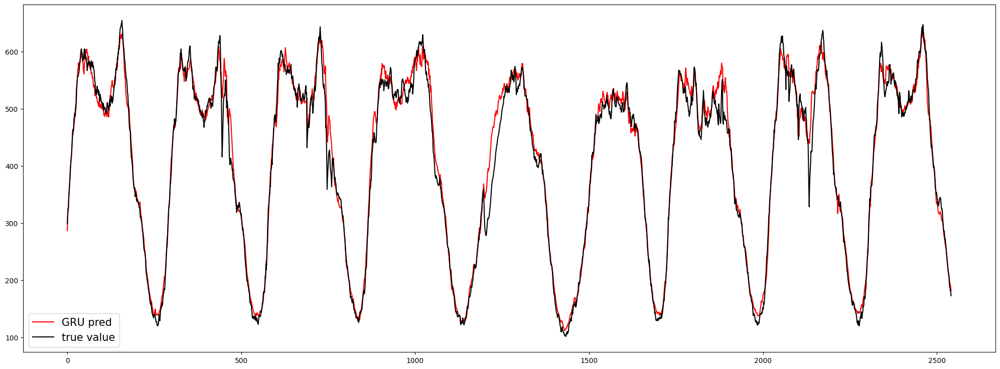

,Signe error,MAE,RMSE,MAPE,SMAPE,MAAPE
Captor,,,,,,
TGCN Model captor 97,-,13.001119,18.000532,ERROR,3.290531,3.332905
LSTM Model captor 97,+,16.782596,23.548892,ERROR,4.277989,4.239786
GRU Model captor 97,+,12.522763,17.962873,ERROR,3.320332,3.411893


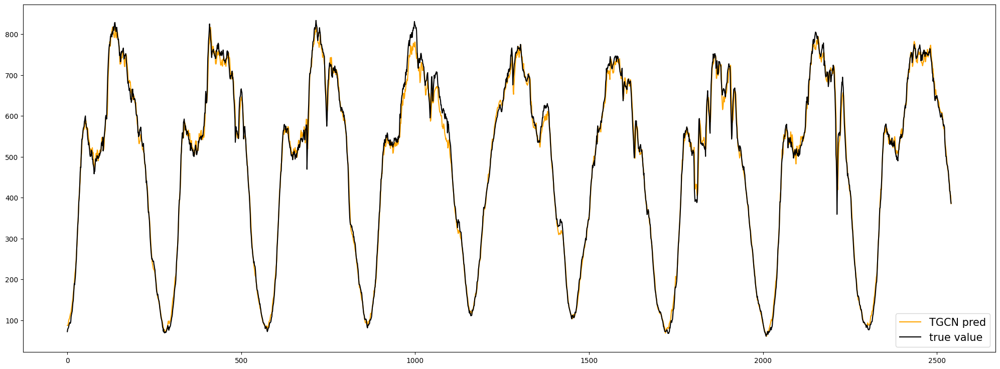

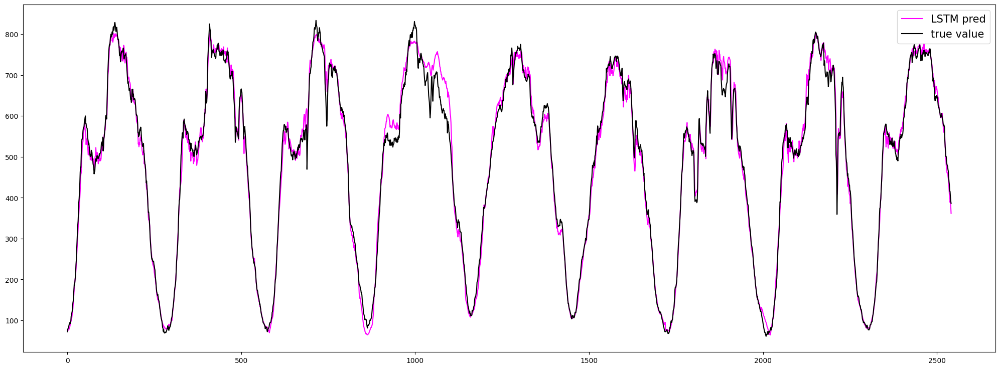

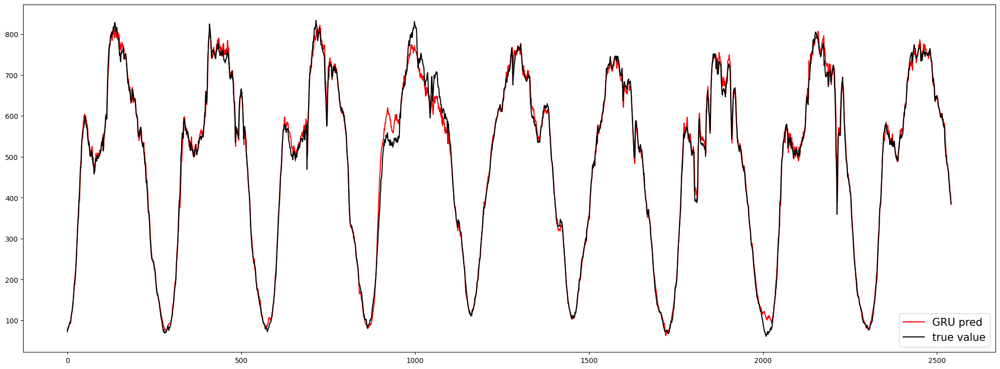

In [100]:
import matplotlib.pyplot as plt

dict_results_multivariate_model = { "TGCN": 0,
                    "LSTM": 0,
                    "GRU": 0
}

######################################################################
# TGCN
######################################################################
# load best model
model_TGCN.load_state_dict(torch.load(f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_TGCN}/TGCN_model.pkl".format(input)))

# Make predictions
predictions_TGCN, actuals_TGCN = test_model_divide_by_max(model_TGCN, test_loader_TGCN, maximum)


######################################################################
# LSTM
######################################################################
# load best model
models_multivariate_LSTM["model"].load_state_dict(torch.load(f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_LSTM_multivariate}/multivariate_LSTM_model.pkl".format(input)))
    
# Make predictions
predictions_LSTM, actuals_LSTM = test_model_divide_by_max(models_multivariate_LSTM["model"], 
                                models_multivariate_GRU["test_loader"], 
                                maximum)


######################################################################
# GRU
######################################################################
# Load best model
models_multivariate_GRU["model"].load_state_dict(torch.load(f"./{normalization}/nb_captor_{n_neighbors+1}/epoch_{num_epochs_GRU_multivariate}/multivariate_GRU_model.pkl".format(input)))

# Make predictions
predictions_GRU, actuals_GRU = test_model_divide_by_max(models_multivariate_GRU["model"], 
                                models_multivariate_GRU["test_loader"],
                                maximum)
    

for i in range(n_neighbors+1):

######################################################################
# TGCN
######################################################################
    # Save result for each captor
    temp = result_prediction(predictions_TGCN[:, i], actuals_TGCN[:, i])
    temp.append(f"TGCN Model captor {df_PeMS.columns[i]}")
    data = [temp]


######################################################################
# LSTM
######################################################################
    # Save result
    temp = result_prediction(predictions_LSTM[:, i], actuals_LSTM[:, i])

    temp.append(f"LSTM Model captor {df_PeMS.columns[i]}")
    data.append(temp)


######################################################################
# GRU
######################################################################
    # Save results
    temp = result_prediction(predictions_GRU[:, i], actuals_GRU[:, i])
    temp.append(f"GRU Model captor {df_PeMS.columns[i]}")
    data.append(temp)


######################################################################
# Dataframe
######################################################################

    df = pd.DataFrame(data, columns=['Signe error', 'MAE', 'RMSE', 'MAPE', 'SMAPE', 'MAAPE', "Captor"])

    # Définir le mois comme index du DataFrame
    df.set_index('Captor', inplace=True)

    pd.set_option('display.max_columns', None)
    pd.set_option('display.max_rows', None)
    pd.set_option('display.width', None)

    min_val = df['MAAPE'].min()
    max_val = df['MAAPE'].max()
    #df = df.style.apply(highlight_col, axis=0, min_val=min_val)
    df = df.style.apply(highlight_rows, axis=1, min_val=min_val, max_val=max_val)
    dict_results_multivariate_model
    display(df)


######################################################################
# Plots
######################################################################

    plt.figure(figsize=(25, 9))
    plt.plot(predictions_TGCN[:, i], color="orange", label="TGCN pred")
    plt.plot(actuals_LSTM[:, i], color="black", label="true value")
    plt.legend(fontsize=15)
    plt.show()
    
    plt.figure(figsize=(25, 9))
    plt.plot(predictions_LSTM[:, i], color="magenta", label="LSTM pred")
    plt.plot(actuals_LSTM[:, i], color="black", label="true value")
    plt.legend(fontsize=15)
    plt.show()
    
    plt.figure(figsize=(25, 9))
    plt.plot(predictions_GRU[:, i], color="red", label="GRU pred" )
    plt.plot(actuals_LSTM[:, i], color="black", label="true value")
    plt.legend(fontsize=15)
    plt.show()
